<a href="https://colab.research.google.com/github/emelyanov-dv/dress_recommender/blob/main/fashion_cv.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 0 Abstract


---


Ноутбук содержит описание шагов и результатов по созданию прототипа поиска в локальной базе платьев, похожих на платья, обнаруженные на произвольном загруженном изображении. 

Каждый пункт содержит выводы и описание дальнейших шагов. 

За основу взят датасет Deepfashion, Category and attribute prediction benchmark с низким разрешением (для быстрой тренировки в колабе) : https://mmlab.ie.cuhk.edu.hk/projects/DeepFashion.html

Для работы выбраны только платья: 
 1. Мощностей колаба и невозможности осуществить тренировку дольше периода таймаута недостаточно, чтобы покрыть все предметы гардероба;
 2. Платья преобладают в датасете.  

---


**Цель:** создание демонстрационного сервиса, принимающего на вход изображение, возвращающего на выход похожие по стилю и фасону предметы гардероба.

**Задачи:**
1. Обучение детектора предметов гардероба;
2. Обучение классификатора на атрибуты предмета гардероба;
3. Организация пайплайна "Детектор -> одежда -> получение эмбеддингов для всех обнаруженных предметов -> рекомендация похожих предметов гардероба.

Для решения выбраны:
1. YOLOv5s: 
 * end-to-end; 
 * SSD вместо TSD;
 * доступность и хорошие показатели"из коробки";
 * минимальное количество параметров для тренировки только на мощностях Колаба. 
2. Resnet-18:    
 * Доступность в PyTorch;
 * Минимальное количество параметров в модели. 



---


**Резюме:**

* **П.1-2** содержат описание загрузки датасета и подготовки аннотаций к формату YOLO;

* **П.3** содержит описание тренировки и тестирования YOLO на ресайзе входного изображения 320 и 640 для обеспечения работы целевого сервиса на произвольных изображениях. 320 - средняя размерность датасета. Прироста к качеству 640 не дал, однако на произвольных изображениях показал себя хуже. В итоговый пайплайн включена модель с ресайзом 320, что соответствует размерности датасета. 
* **П.4** содержит описание тренировки Resnet.
* **П.5** содаржит описание **выявленной проблемы** работы пайплайна YOLO+resnet: косинусная похожесть эмбеддинга вырезанного после YOLO платья сильно отличается от эмбеддинга платья из датасета.
* **П.6** содержит описание попытки устранения проблемы путем обучения resnet на датасете изображений, вырезанных по аннотациям из датасета. Попытка неуспешная: косинусная схожесть эмбеддингов вырезанных по аннотациям изображений и полноразмерных изображений очень низкая, что не позволяет осуществлять рекомендации похожих платьев. 
* В **П.7** описано **решение проблемы** работы пайплайна: обучение resnet проведено на основе вырезанных по итогам детекции YOLO платьев (не по аннотациям). 
* **П.8** содержит демо корректной работы пайплайна.  














Пример работы сервиса. 

Входное изображение и детекция платья:    
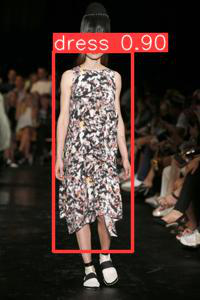

Выходное изображение: рекомендации похожих платьев.


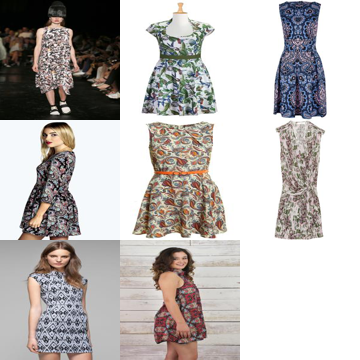

In [ ]:
import os
import pandas as pd
import numpy as np

import cv2
from PIL import Image

from matplotlib import pyplot as plt
%matplotlib inline
import seaborn as sns

from shutil import move, copy
from distutils.dir_util import copy_tree

import torch
from torch import nn
from torch import optim
from torch.utils.data import Dataset, DataLoader, SubsetRandomSampler
from torchvision.io import read_image 
import torchvision.transforms.functional as F
from torchvision import transforms, models

plt.rcParams["savefig.bbox"] = 'tight'

import urllib.request
import pickle

from sklearn.metrics.pairwise import cosine_similarity
from sklearn.preprocessing import normalize

#1 Load and extract the dataset from the Drive archive

In [ ]:
#if the Drive is connected, extract data
path_to_dataset = os.path.join(os.getcwd(), 'drive')
if os.path.exists(path_to_dataset):
  
  !cp -R /content/drive/MyDrive/dataset /content/dataset
  !unzip /content/drive/MyDrive/dataset/img.zip -d /content/dataset
  %cd dataset
else:
  print('!!!Connect Drive!!!')

Выходные данные были обрезаны до нескольких последних строк (5000).
  inflating: /content/dataset/img/Woven_Dolphin_Shorts/img_00000028.jpg  
  inflating: /content/dataset/img/Woven_Dolphin_Shorts/img_00000029.jpg  
  inflating: /content/dataset/img/Woven_Dolphin_Shorts/img_00000030.jpg  
  inflating: /content/dataset/img/Woven_Dolphin_Shorts/img_00000031.jpg  
  inflating: /content/dataset/img/Woven_Dolphin_Shorts/img_00000032.jpg  
  inflating: /content/dataset/img/Woven_Dolphin_Shorts/img_00000033.jpg  
  inflating: /content/dataset/img/Woven_Dolphin_Shorts/img_00000034.jpg  
  inflating: /content/dataset/img/Woven_Dolphin_Shorts/img_00000035.jpg  
  inflating: /content/dataset/img/Woven_Dolphin_Shorts/img_00000036.jpg  
  inflating: /content/dataset/img/Woven_Dolphin_Shorts/img_00000037.jpg  
   creating: /content/dataset/img/Woven_Drawstring_Joggers/
  inflating: /content/dataset/img/Woven_Drawstring_Joggers/img_00000001.jpg  
  inflating: /content/dataset/img/Woven_Drawstring_Jog

# 2 Convert boundary annotations to YOLO format

In [ ]:
def convert_coordinates(image_size, bbox_coordinates):
  """
    convert bbox to yolo format
  """
  x1 = int(bbox_coordinates[0])
  y1 = int(bbox_coordinates[1])
  x2 = int(bbox_coordinates[2])
  y2 = int(bbox_coordinates[3])

  dw = np.float32(1. / int(image_size[1]))
  dh = np.float32(1. / int(image_size[0]))

  w = x2 - x1
  h = y2 - y1
  x = x1 + (w / 2)
  y = y1 + (h / 2)

  x = x * dw
  w = w * dw
  y = y * dh
  h = h * dh
  return [x, y, w, h]

def get_image_size(image_path):
  """
    get image size to normalized transformed bboxes
  """
  INPUT_PATH = os.path.join('/content', 'dataset')
  image_path = os.path.join(INPUT_PATH, image_path)
  
  try: 
    if not os.path.exists(image_path):
      raise Exception(image_path + 'does not exist. Breaking...')
  except Exception as e:
    print(e.args)
    return (0,0,0)
    # pass
  # print(image_path)
  img = cv2.imread(image_path)
  # plt.imshow(img)
  return img.shape

def write_to_file(category, bbox_coordinates, filename):
  """
    function to append new bbox to annotation file
  """

  with open(filename, 'a+') as f:
    f.write(f"{category} {bbox_coordinates[0]} {bbox_coordinates[1]} {bbox_coordinates[2]} {bbox_coordinates[3]}\n")
  return 0

def create_annotations(sample_file_list, bbox_file, category_file, output_file):
  """
    Creates output anno file in [category, x_center, y_center, widht/2, height/2]
    notation.
  """
  with open(sample_file_list, 'r') as f:
    filenames = f.readlines()

  with open(bbox_file, 'r') as f:
    bboxes = f.readlines()

  with open(category_file, 'r') as f:
    categories = f.readlines()
# loop through zipped filename, category and bboxes
  for filename, bbox, cat in list(zip(filenames, bboxes, categories)):
    # convert to int list
    bbox = list(map(int, bbox[:-2].split(sep=' ')))
    
    # get image size to use in new coordinates calc
    img_size = get_image_size(filename[:-1])
    #check if transformation normalized
    try:
      new_coordinates = convert_coordinates(img_size, bbox)
      # print(new_coordinates)
      if not np.all(np.array(new_coordinates) < 1):
        raise Exception('transformed values should be normalized over axes')
    except Exception as e:
      print(e.args)
      break
    
    #convert to 0-indexing categories
    category = int(cat) - 1
    if category == 40:
      category = 0
    else: 
      category = 999
    write_to_file(category, new_coordinates , output_file)
    
# simple check
dummy_size = (300, 236, 3)
dummy_bbox = (75, 43, 176, 300 )
dummy_result = convert_coordinates(dummy_size, dummy_bbox)
assert np.all(np.array(dummy_result) < 1), 'transformed values should be normalized over axes'

Create annotations 

In [ ]:
%%time
%cd /content/dataset
create_annotations('/content/dataset/train.txt', '/content/dataset/train_bbox.txt', 
          '/content/dataset/train_cate.txt', '/content/dataset/train_annotations.txt')
create_annotations('/content/dataset/val.txt', '/content/dataset/val_bbox.txt', 
          '/content/dataset/val_cate.txt', '/content/dataset/val_annotations.txt')
create_annotations('/content/dataset/test.txt', '/content/dataset/test_bbox.txt', 
          '/content/dataset/test_cate.txt', '/content/dataset/test_annotations.txt')

/content/dataset
CPU times: user 17.5 s, sys: 1.45 s, total: 18.9 s
Wall time: 26.2 s


Organize folder structure due to satisfy yolo requierments

In [ ]:
# if os.path.exists('/content/dataset/train/'):
#   !rm -rf /content/dataset/train/
#   !rm -rf /content/dataset/val/
#   !rm -rf /content/dataset/test/

In [ ]:
import random
!mkdir /content/dataset/train/
!mkdir /content/dataset/train/images/
!mkdir /content/dataset/train/labels

!mkdir /content/dataset/val/
!mkdir /content/dataset/val/images/
!mkdir /content/dataset/val/labels

!mkdir /content/dataset/test/
!mkdir /content/dataset/test/images/
!mkdir /content/dataset/test/labels

%cd/content/dataset

def organize_folder_structure(foldname):
  """
  foldname either 'train', or 'val', or 'test'
  """
  with open('/content/dataset/'+foldname+'.txt', 'r') as f:
        file_list = f.readlines()
  with open('/content/dataset/'+foldname+'_annotations.txt', 'r') as f:
        annotations = f.readlines()

  total = 0
  non_dress_counter = 0

  zipped = list(zip(file_list, annotations))
  random.shuffle(zipped)
  for filename, annotation in zipped:
    filename = filename[:-1]
    annotation = annotation[:-1]

  #  create filename for replace and replace image
    img_dir_name = os.path.basename(os.path.dirname(filename) )
    img_name = os.path.basename(filename)
    aim_filename = img_dir_name+'_'+img_name

  # creates 10% of background images for train and do not filter for val and test
  # if dress create both image and label file
  # if not, only image file writes and continue next loop iteration
    if annotation.split(' ')[0] == '0':
      label_path = os.path.basename( aim_filename.replace('.jpg', '.txt'))
      label_path = os.path.join('/content/dataset/'+foldname+'/labels/'+ label_path)
      with open(label_path, 'w') as f:
        f.write(annotation)
    else:
      non_dress_counter+=1
      if (foldname == 'train') & (non_dress_counter > 400):
        continue
      if (foldname == 'test') & (non_dress_counter > 100):
        continue    
    total+=1
    copy(filename, '/content/dataset/'+foldname+'/images/'+ aim_filename)
    
  print("Total non_dresses in the dataset: {}, Total:{}".format(non_dress_counter, total))

In [ ]:
for fold in ['train'
, 'val', 'test'
]:
  organize_folder_structure(fold)

Total non_dresses in the dataset: 9984, Total:4416
Total non_dresses in the dataset: 1411, Total:2000
Total non_dresses in the dataset: 2936, Total:1164


#3 YOLOv5s training and testing

## 3.1. Create YAML config and download YOLO

In [ ]:
categories = ['dress']
!echo "path: /content/dataset" > /content/dataset/detector.yaml
!echo "train: train" >> /content/dataset/detector.yaml
!echo "val:   val" >> /content/dataset/detector.yaml
!echo "test:  test" >> /content/dataset/detector.yaml

!echo "nc : 1" >> /content/dataset/detector.yaml
!echo "names: {list(categories)}" >> /content/dataset/detector.yaml

!cat /content/dataset/detector.yaml

path: /content/dataset
train: train
val:   val
test:  test
nc : 1
names: ['dress']


In [ ]:
%cd /content
!git clone https://github.com/ultralytics/yolov5
%cd yolov5
!pip install -r requirements.txt

/content
Cloning into 'yolov5'...
remote: Enumerating objects: 10025, done.
remote: Counting objects: 100% (17/17), done.
remote: Compressing objects: 100% (12/12), done.
remote: Total 10025 (delta 6), reused 11 (delta 5), pack-reused 10008
Receiving objects: 100% (10025/10025), 10.30 MiB | 9.93 MiB/s, done.
Resolving deltas: 100% (6943/6943), done.
/content/yolov5
     |████████████████████████████████| 596 kB 4.1 MB/s 
  Attempting uninstall: PyYAML
    Found existing installation: PyYAML 3.13
    Uninstalling PyYAML-3.13:
      Successfully uninstalled PyYAML-3.13


## 3.2. 100 epoch YOLO train with 320 image size

Images have 320 mean size, so it is selected to be used as resize dimension in yolo preprocessing

In [ ]:
!python3 train.py --img 320 --batch 300 --epochs 100 --data /content/dataset/detector.yaml --cfg models/yolov5s.yaml --weights yolov5s.pt

train: weights=yolov5s.pt, cfg=models/yolov5s.yaml, data=/content/dataset/detector.yaml, hyp=data/hyps/hyp.scratch.yaml, epochs=100, batch_size=300, imgsz=320, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, adam=False, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, linear_lr=False, label_smoothing=0.0, patience=100, freeze=0, save_period=-1, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v5.0-500-g276b674 torch 1.9.0+cu111 CUDA:0 (Tesla P100-PCIE-16GB, 16280.875MB)

hyperparameters: lr0=0.01, lrf=0.2, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamma=0.0, hsv_h=0.015, hsv_s=0.7, h

In [ ]:
copy('/content/yolov5/runs/train/exp4/weights/best.pt', '/content/drive/MyDrive/yolo_weights/dress_only_best_100.pt')
copy('/content/yolov5/runs/train/exp4/weights/last.pt', '/content/drive/MyDrive/yolo_weights/dress_only_last_100.pt')

'/content/drive/MyDrive/yolo_weights/dress_only_last_100.pt'

**Training result:**


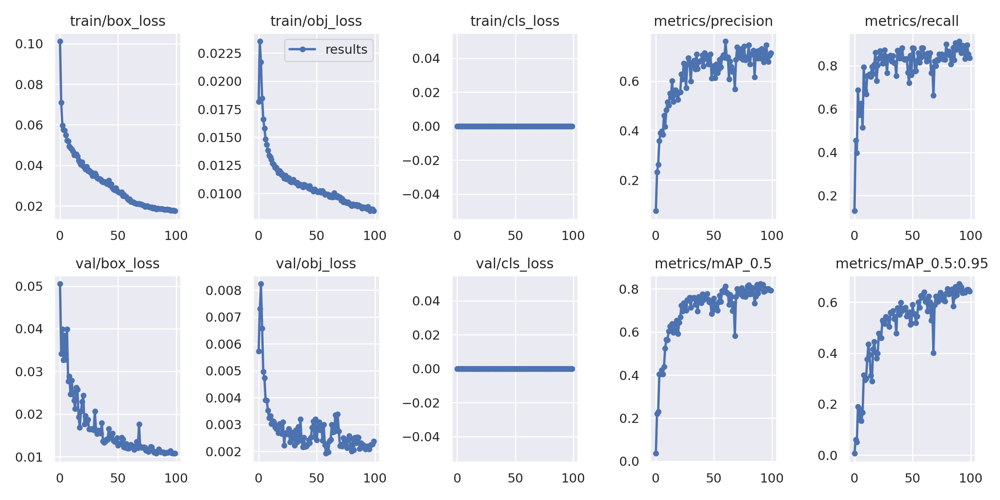



**Conlusion:** it's not clear were it underfit or overfit, looking at the loss plots.

**Decision:** train again up to 300 epochs

## 3.3 300 epoch YOLO train with 320 image size

In [ ]:
!python3 train.py --img 320 --batch 320 --epochs 300 --data /content/dataset/detector.yaml --cfg models/yolov5s.yaml --weights yolov5s.pt

train: weights=yolov5s.pt, cfg=models/yolov5s.yaml, data=/content/dataset/detector.yaml, hyp=data/hyps/hyp.scratch.yaml, epochs=300, batch_size=320, imgsz=320, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, adam=False, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, linear_lr=False, label_smoothing=0.0, patience=100, freeze=0, save_period=-1, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v5.0-506-g7d37b3c torch 1.9.0+cu111 CUDA:0 (Tesla P100-PCIE-16GB, 16280.875MB)

hyperparameters: lr0=0.01, lrf=0.2, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamma=0.0, hsv_h=0.015, hsv_s=0.7, h

In [ ]:
copy('/content/yolov5/runs/train/exp2/weights/best.pt', '/content/drive/MyDrive/yolo_weights/dress_only_best_300.pt')
copy('/content/yolov5/runs/train/exp2/weights/last.pt', '/content/drive/MyDrive/yolo_weights/dress_only_last_300.pt')

copy_tree('/content/yolov5/runs/train/exp2', '/content/drive/MyDrive/yolo_weights/dress_only_300_epoch')

['/content/drive/MyDrive/yolo_weights/dress_only_300_epoch/val_batch0_pred.jpg',
 '/content/drive/MyDrive/yolo_weights/dress_only_300_epoch/results.csv',
 '/content/drive/MyDrive/yolo_weights/dress_only_300_epoch/results.png',
 '/content/drive/MyDrive/yolo_weights/dress_only_300_epoch/PR_curve.png',
 '/content/drive/MyDrive/yolo_weights/dress_only_300_epoch/val_batch2_labels.jpg',
 '/content/drive/MyDrive/yolo_weights/dress_only_300_epoch/val_batch1_labels.jpg',
 '/content/drive/MyDrive/yolo_weights/dress_only_300_epoch/R_curve.png',
 '/content/drive/MyDrive/yolo_weights/dress_only_300_epoch/hyp.yaml',
 '/content/drive/MyDrive/yolo_weights/dress_only_300_epoch/val_batch1_pred.jpg',
 '/content/drive/MyDrive/yolo_weights/dress_only_300_epoch/events.out.tfevents.1633936088.72eaafaf8415.570.0',
 '/content/drive/MyDrive/yolo_weights/dress_only_300_epoch/val_batch0_labels.jpg',
 '/content/drive/MyDrive/yolo_weights/dress_only_300_epoch/labels_correlogram.jpg',
 '/content/drive/MyDrive/yolo_w

**Results:**
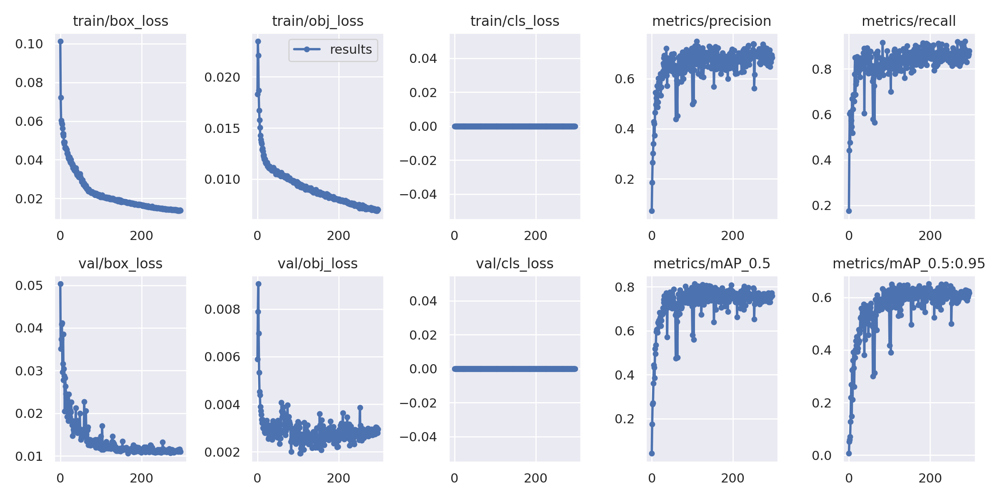

**Conlusion:** overfitting is detected.

**Decision:** use 100 epochs best weights.

## 3.4 100 epoch train with 640 image size

The reason why it was decided to learn with 640 resize: 
1. While teseting at arbitary images not from fasion-cv dataset (see 3.7) YOLO with 320 has shown worse results;
2. It could be several ways to medicate it:    
  * Learn at larger resize to handle bigger images;
  * Learn at unsquared pictures (in dataset the majority is squared with dress centered and resize make it skewed);
3. The only appropriate way was to try 640 resize, which seems to be adequate not to skewed dataset images much.  

In [ ]:
!python3 train.py --batch 80 --epochs 100 --data /content/dataset/detector.yaml --cfg models/yolov5s.yaml --weights yolov5s.pt

train: weights=yolov5s.pt, cfg=models/yolov5s.yaml, data=/content/dataset/detector.yaml, hyp=data/hyps/hyp.scratch.yaml, epochs=100, batch_size=80, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, adam=False, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, linear_lr=False, label_smoothing=0.0, patience=100, freeze=0, save_period=-1, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v6.0-25-g15e8c4c torch 1.9.0+cu111 CUDA:0 (Tesla P100-PCIE-16GB, 16280.875MB)

hyperparameters: lr0=0.01, lrf=0.1, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamma=0.0, hsv_h=0.015, hsv_s=0.7, hsv

In [ ]:
copy('/content/yolov5/runs/train/exp4/weights/best.pt', '/content/drive/MyDrive/yolo_weights/dress_only_img640_best_100.pt')
copy('/content/yolov5/runs/train/exp4/weights/last.pt', '/content/drive/MyDrive/yolo_weights/dress_only_img640_last_100.pt')

'/content/drive/MyDrive/yolo_weights/dress_only_img640_last_100.pt'

In [ ]:
copy_tree('/content/yolov5/runs/train/exp4', '/content/drive/MyDrive/yolo_weights/dress_only_100_img640_epoch')

['/content/drive/MyDrive/yolo_weights/dress_only_100_img640_epoch/val_batch0_labels.jpg',
 '/content/drive/MyDrive/yolo_weights/dress_only_100_img640_epoch/labels_correlogram.jpg',
 '/content/drive/MyDrive/yolo_weights/dress_only_100_img640_epoch/labels.jpg',
 '/content/drive/MyDrive/yolo_weights/dress_only_100_img640_epoch/hyp.yaml',
 '/content/drive/MyDrive/yolo_weights/dress_only_100_img640_epoch/train_batch2.jpg',
 '/content/drive/MyDrive/yolo_weights/dress_only_100_img640_epoch/results.csv',
 '/content/drive/MyDrive/yolo_weights/dress_only_100_img640_epoch/F1_curve.png',
 '/content/drive/MyDrive/yolo_weights/dress_only_100_img640_epoch/results.png',
 '/content/drive/MyDrive/yolo_weights/dress_only_100_img640_epoch/train_batch0.jpg',
 '/content/drive/MyDrive/yolo_weights/dress_only_100_img640_epoch/val_batch1_labels.jpg',
 '/content/drive/MyDrive/yolo_weights/dress_only_100_img640_epoch/opt.yaml',
 '/content/drive/MyDrive/yolo_weights/dress_only_100_img640_epoch/PR_curve.png',
 '/c

In [ ]:
copy('/content/drive/MyDrive/yolo_weights/dress_only_img640_best_100.pt', '/content/dataset/best.pt',)

!python3 val.py --batch 64 --weights /content/dataset/best.pt \
  --data /content/dataset/detector.yaml --conf 0.2 --iou 0.2 --verbose --task test --half

val: data=/content/dataset/detector.yaml, weights=['/content/dataset/best.pt'], batch_size=80, imgsz=640, conf_thres=0.2, iou_thres=0.2, task=test, device=, single_cls=False, augment=False, verbose=True, save_txt=False, save_hybrid=False, save_conf=False, save_json=False, project=runs/val, name=exp, exist_ok=False, half=True
YOLOv5 🚀 v6.0-30-gfee83c1 torch 1.9.0+cu111 CUDA:0 (Tesla P100-PCIE-16GB, 16280.875MB)

Fusing layers... 
Model Summary: 213 layers, 7012822 parameters, 0 gradients, 15.8 GFLOPs
test: Scanning '/content/dataset/test/labels' images and labels...1064 found, 100 missing, 0 empty, 0 corrupted: 100% 1164/1164 [00:00<00:00, 2988.43it/s]
test: New cache created: /content/dataset/test/labels.cache
               Class     Images     Labels          P          R     mAP@.5 mAP@.5:.95: 100% 15/15 [00:12<00:00,  1.17it/s]
                 all       1164       1064      0.943      0.974      0.971      0.828
Speed: 0.8ms pre-process, 3.6ms inference, 1.4ms NMS per image at sha

**Results:** 
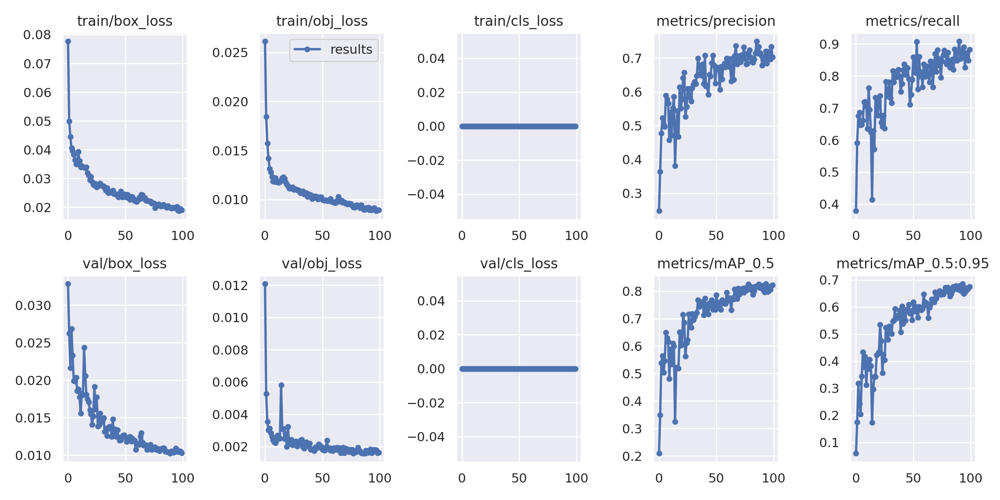

**Conlusion:** again it's not clear is it underfit or overfit.

**Decision:** try 300 epochs.

##3.5. 300 epoch train with 640 img size constraint

In [ ]:
!python3 train.py --batch 64 --epochs 300 --data /content/dataset/detector.yaml --cfg models/yolov5s.yaml --weights yolov5s.pt

train: weights=yolov5s.pt, cfg=models/yolov5s.yaml, data=/content/dataset/detector.yaml, hyp=data/hyps/hyp.scratch.yaml, epochs=300, batch_size=64, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, adam=False, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, linear_lr=False, label_smoothing=0.0, patience=100, freeze=0, save_period=-1, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v6.0-31-g3d89798 torch 1.9.0+cu111 CUDA:0 (Tesla P100-PCIE-16GB, 16280.875MB)

hyperparameters: lr0=0.01, lrf=0.1, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamma=0.0, hsv_h=0.015, hsv_s=0.7, hsv

In [ ]:
copy_tree('/content/yolov5/runs/train/exp', '/content/drive/MyDrive/yolo_weights/dress_only_300_img640_epoch')

['/content/drive/MyDrive/yolo_weights/dress_only_300_img640_epoch/val_batch0_labels.jpg',
 '/content/drive/MyDrive/yolo_weights/dress_only_300_img640_epoch/events.out.tfevents.1635143212.7d99be76072f.349.0',
 '/content/drive/MyDrive/yolo_weights/dress_only_300_img640_epoch/labels_correlogram.jpg',
 '/content/drive/MyDrive/yolo_weights/dress_only_300_img640_epoch/labels.jpg',
 '/content/drive/MyDrive/yolo_weights/dress_only_300_img640_epoch/hyp.yaml',
 '/content/drive/MyDrive/yolo_weights/dress_only_300_img640_epoch/train_batch2.jpg',
 '/content/drive/MyDrive/yolo_weights/dress_only_300_img640_epoch/results.csv',
 '/content/drive/MyDrive/yolo_weights/dress_only_300_img640_epoch/F1_curve.png',
 '/content/drive/MyDrive/yolo_weights/dress_only_300_img640_epoch/results.png',
 '/content/drive/MyDrive/yolo_weights/dress_only_300_img640_epoch/train_batch0.jpg',
 '/content/drive/MyDrive/yolo_weights/dress_only_300_img640_epoch/val_batch1_labels.jpg',
 '/content/drive/MyDrive/yolo_weights/dress_

**Results:** 
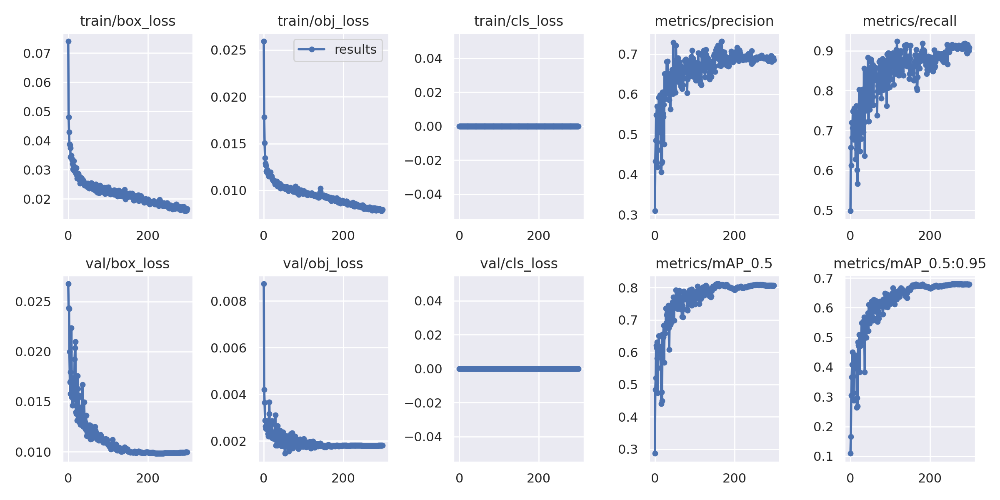

**Conclusion:** there is slight overfit, but it is appropriate to use best weights.

**Next step:** compare models with 320 and 640 resize at TEST fold and aribatary images.

##3.6. Test trained YOLO at test fold of dataset

Test with 640 (YOLO default) resize:

In [ ]:
copy('/content/drive/MyDrive/yolo_weights/dress_only_300_img640_epoch/weights/best.pt', '/content/dataset/best.pt',)

!python3 val.py --batch 64 --weights /content/dataset/best.pt \
  --data /content/dataset/detector.yaml --conf 0.2 --iou 0.2 --verbose --task test --half

val: data=/content/dataset/detector.yaml, weights=['/content/dataset/best.pt'], batch_size=64, imgsz=640, conf_thres=0.2, iou_thres=0.2, task=test, device=, single_cls=False, augment=False, verbose=True, save_txt=False, save_hybrid=False, save_conf=False, save_json=False, project=runs/val, name=exp, exist_ok=False, half=True
YOLOv5 🚀 v6.0-31-g3d89798 torch 1.9.0+cu111 CUDA:0 (Tesla P100-PCIE-16GB, 16280.875MB)

Fusing layers... 
Model Summary: 213 layers, 7012822 parameters, 0 gradients, 15.8 GFLOPs
test: Scanning '/content/dataset/test/labels' images and labels...1064 found, 100 missing, 0 empty, 0 corrupted: 100% 1164/1164 [00:00<00:00, 1354.03it/s]
test: New cache created: /content/dataset/test/labels.cache
               Class     Images     Labels          P          R     mAP@.5 mAP@.5:.95: 100% 19/19 [00:11<00:00,  1.62it/s]
                 all       1164       1064       0.94      0.979      0.973      0.833
Speed: 0.1ms pre-process, 3.4ms inference, 1.4ms NMS per image at sha

Test with 320 resize:

In [ ]:
copy('/content/drive/MyDrive/yolo_weights/dress_only_best_100.pt', '/content/dataset/best.pt',)

!python3 val.py --batch 300 --img 320 --weights /content/dataset/best.pt \
  --data /content/dataset/detector.yaml --conf 0.2 --iou 0.2 --verbose --task test --half

val: data=/content/dataset/detector.yaml, weights=['/content/dataset/best.pt'], batch_size=300, imgsz=320, conf_thres=0.2, iou_thres=0.2, task=test, device=, single_cls=False, augment=False, verbose=True, save_txt=False, save_hybrid=False, save_conf=False, save_json=False, project=runs/val, name=exp, exist_ok=False, half=True
YOLOv5 🚀 v6.0-2-g26784af torch 1.9.0+cu111 CUDA:0 (Tesla P100-PCIE-16GB, 16280.875MB)

Fusing layers... 
Model Summary: 224 layers, 7053910 parameters, 0 gradients
test: Scanning '/content/dataset/test/labels' images and labels...1064 found, 100 missing, 0 empty, 0 corrupted: 100% 1164/1164 [00:00<00:00, 2000.79it/s]
test: New cache created: /content/dataset/test/labels.cache
               Class     Images     Labels          P          R     mAP@.5 mAP@.5:.95: 100% 4/4 [00:12<00:00,  3.19s/it]
                 all       1164       1064      0.941       0.97      0.969      0.814
Speed: 0.0ms pre-process, 1.9ms inference, 3.5ms NMS per image at shape (300, 3, 320

**Conclusion:** at test fold metrics are comparable.
**Next step:** test at arbitary images. 

##3.7. Test at arbitary images

Check not only at dataset pictures

In [ ]:
# check how different input size influent at result bbox
# load yolo
copy('/content/drive/MyDrive/yolo_weights/dress_only_best_100.pt', '/content/yolo_best.pt',)
yolo320 = torch.hub.load('ultralytics/yolov5', 'custom', path='/content/yolo_best.pt')
yolo320.conf = 0.2  # like it was trained
yolo320.iou = 0.2 # like it was trained

# load yolo
copy('/content/drive/MyDrive/yolo_weights/dress_only_img640_best_100.pt', '/content/yolo_best.pt',)
yolo640 = torch.hub.load('ultralytics/yolov5', 'custom', path='/content/yolo_best.pt')
yolo640.conf = 0.2  # like it was trained
yolo640.iou = 0.2 # like it was trained

def predict_url_bbox(model, image_link, show = False):
  urllib.request.urlretrieve(link,"image.jpg")
  img = Image.open("image.jpg")
  
  result = model(img)
  
  result.print()
  print(f'img.size = {img.size}')

  result.save('/content/')
  print(result.pandas().xyxy)
  
  if show:
    img_detected = Image.open('/content/image.jpg')
    display(img_detected)
  return img, result.pandas().xyxy[0]

Using cache found in /root/.cache/torch/hub/ultralytics_yolov5_master


requirements: PyYAML>=5.3.1 not found and is required by YOLOv5, attempting auto-update...


YOLOv5 🚀 2021-10-23 torch 1.9.0+cu111 CUDA:0 (Tesla P100-PCIE-16GB, 16280.875MB)

Fusing layers... 



requirements: 1 package updated per /root/.cache/torch/hub/ultralytics_yolov5_master/requirements.txt
requirements: ⚠️ Restart runtime or rerun command for updates to take effect



Model Summary: 224 layers, 7053910 parameters, 0 gradients
Adding AutoShape... 
Using cache found in /root/.cache/torch/hub/ultralytics_yolov5_master


requirements: PyYAML>=5.3.1 not found and is required by YOLOv5, attempting auto-update...


YOLOv5 🚀 2021-10-23 torch 1.9.0+cu111 CUDA:0 (Tesla P100-PCIE-16GB, 16280.875MB)

Fusing layers... 



requirements: 1 package updated per /root/.cache/torch/hub/ultralytics_yolov5_master/requirements.txt
requirements: ⚠️ Restart runtime or rerun command for updates to take effect



Model Summary: 213 layers, 7012822 parameters, 0 gradients
Adding AutoShape... 


image 1/1: 900x600 (no detections)
Speed: 11.3ms pre-process, 12.3ms inference, 0.5ms NMS per image at shape (1, 3, 640, 448)
Saved 1 image to /content


img.size = (600, 900)
[Empty DataFrame
Columns: [xmin, ymin, xmax, ymax, confidence, class, name]
Index: []]


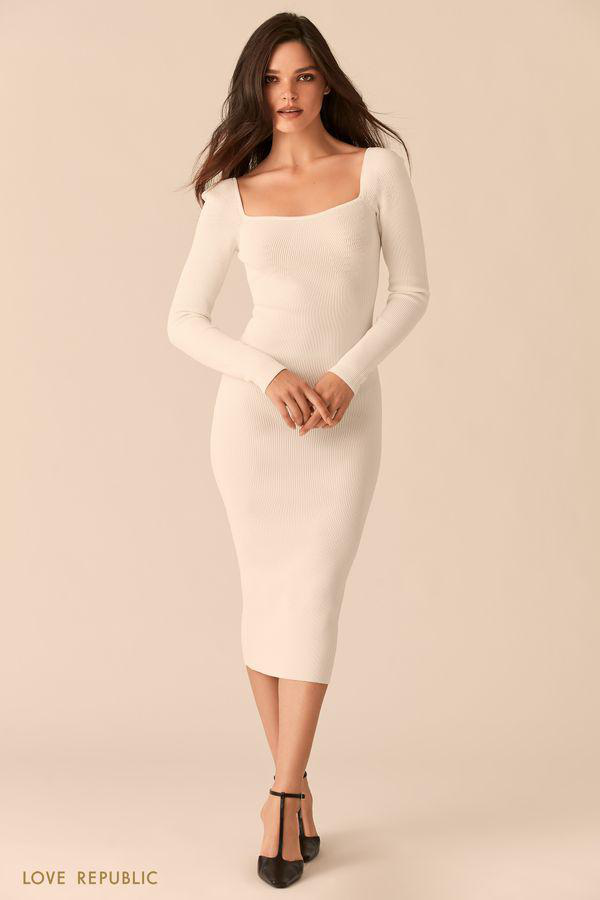

image 1/1: 900x600 1 dress
Speed: 9.9ms pre-process, 10.1ms inference, 1.3ms NMS per image at shape (1, 3, 640, 448)
Saved 1 image to /content


img.size = (600, 900)
[         xmin      ymin      xmax        ymax  confidence  class   name
0  158.144531  109.6875  432.1875  724.921875    0.896973      0  dress]


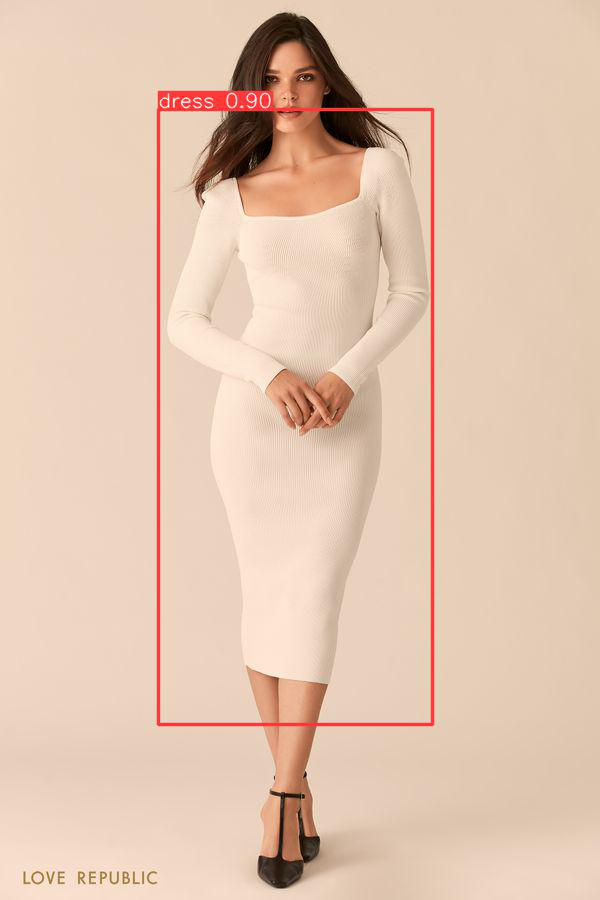

image 1/1: 415x625 11 dresss
Speed: 6.9ms pre-process, 12.6ms inference, 1.2ms NMS per image at shape (1, 3, 448, 640)
Saved 1 image to /content


img.size = (625, 415)
[          xmin        ymin        xmax        ymax  confidence  class   name
0   276.855438   31.779783  353.027313  149.638657    0.891113      0  dress
1   191.162094  248.027328  254.638657  347.636719    0.883789      0  dress
2   194.824203   39.927975  256.103485  132.670883    0.882324      0  dress
3   101.318352   35.350338  163.818344  127.421860    0.881836      0  dress
4   465.087860   37.700191  526.367126  138.774399    0.876953      0  dress
5   474.365204  246.806625  533.691345  347.392578    0.827637      0  dress
6   537.109314   27.507322  622.070251  121.562485    0.803711      0  dress
7   374.999969  249.003891  441.406219  345.683594    0.761719      0  dress
8   557.617126  245.585922  612.304626  376.445312    0.723145      0  dress
9   372.314423   38.981930  418.701141  135.722641    0.710938      0  dress
10  291.015594  248.515610  352.539032  332.011719    0.429199      0  dress]


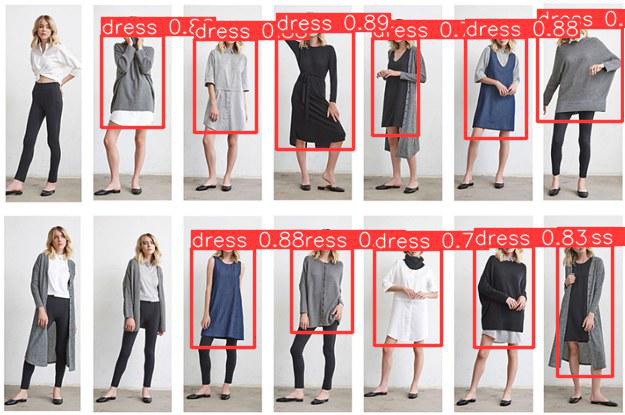

image 1/1: 415x625 9 dresss
Speed: 9.6ms pre-process, 10.3ms inference, 1.4ms NMS per image at shape (1, 3, 448, 640)


img.size = (625, 415)


Saved 1 image to /content


[         xmin        ymin        xmax        ymax  confidence  class   name
0  194.457993   35.838619  256.103485  140.605453    0.640625      0  dress
1  101.074211   32.664791  162.597641  129.130844    0.559082      0  dress
2  193.115219  250.957031  253.662094  346.660156    0.456055      0  dress
3  287.353485  249.492172  349.853485  334.941406    0.312988      0  dress
4  470.947235  248.271469  533.203064  353.251953    0.304932      0  dress
5  281.249969   25.249022  348.144501  154.399399    0.293457      0  dress
6  107.727043  245.585922  164.062485  404.277344    0.273682      0  dress
7  466.552704   33.000484  523.437439  136.210922    0.232178      0  dress
8  377.441376  246.318344  441.406219  353.740234    0.209351      0  dress]


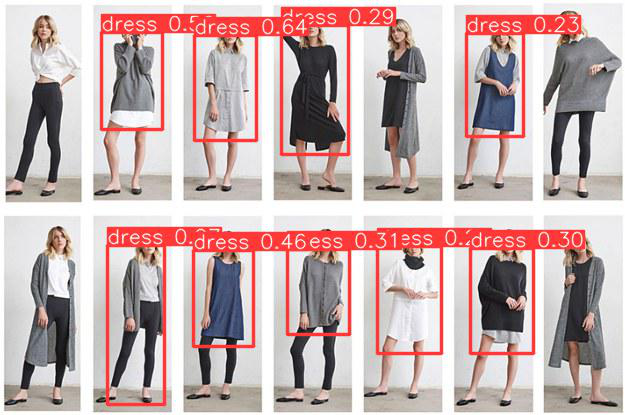

image 1/1: 1060x1693 5 dresss
Speed: 41.9ms pre-process, 11.9ms inference, 1.2ms NMS per image at shape (1, 3, 416, 640)
Saved 1 image to /content


img.size = (1693, 1060)
[          xmin        ymin         xmax        ymax  confidence  class   name
0    66.876808  155.688278   318.098846  658.297668    0.881348      0  dress
1   396.796875  179.826767   616.357849  926.796875    0.874023      0  dress
2   736.719543  155.522949   945.699219  733.689087    0.717285      0  dress
3  1353.077393  145.768356  1601.736694  873.229309    0.668457      0  dress
4  1017.122681  166.930862  1300.171143  654.991028    0.547852      0  dress]


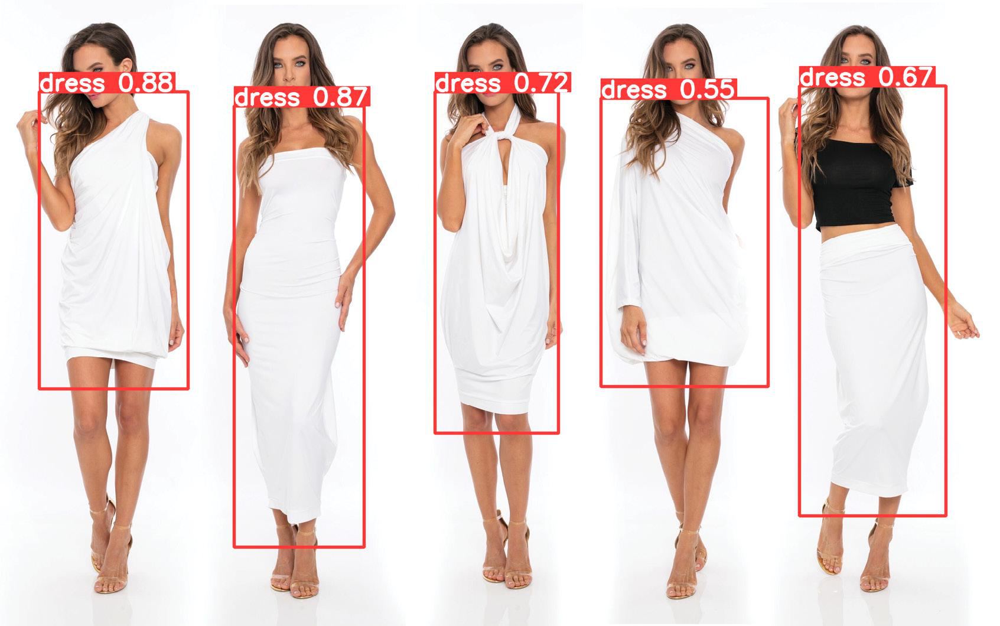

image 1/1: 1060x1693 4 dresss
Speed: 38.3ms pre-process, 9.8ms inference, 1.2ms NMS per image at shape (1, 3, 416, 640)
Saved 1 image to /content


img.size = (1693, 1060)
[          xmin        ymin         xmax        ymax  confidence  class   name
0    55.964893  148.579010   318.760162  658.958984    0.823242      0  dress
1   740.687500  148.413681   953.635193  743.609009    0.535156      0  dress
2  1019.768005  145.603027  1300.171143  653.668396    0.426025      0  dress
3  1343.818726  135.187119  1579.251587  887.117188    0.233643      0  dress]


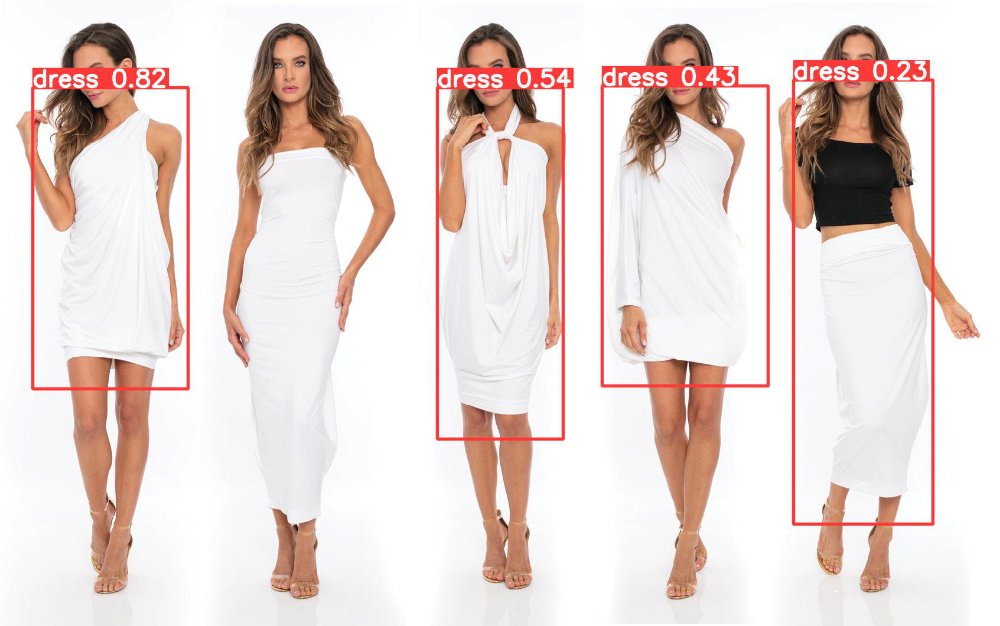

image 1/1: 806x600 3 dresss
Speed: 25.2ms pre-process, 12.7ms inference, 1.2ms NMS per image at shape (1, 3, 640, 480)
Saved 1 image to /content


img.size = (600, 806)
[         xmin        ymin        xmax        ymax  confidence  class   name
0  338.725800  384.739044  506.222656  663.060913    0.854004      0  dress
1    1.606836  394.814056  142.105865  648.578125    0.704590      0  dress
2  236.086700   94.138283  370.210175  385.998444    0.505371      0  dress]


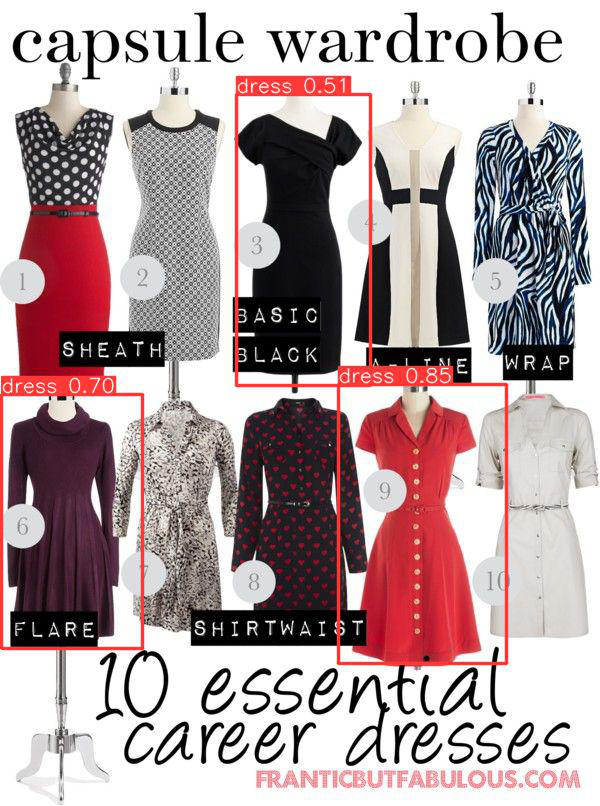

image 1/1: 806x600 7 dresss
Speed: 17.2ms pre-process, 13.8ms inference, 1.9ms NMS per image at shape (1, 3, 640, 480)
Saved 1 image to /content


img.size = (600, 806)
[         xmin        ymin        xmax        ymax  confidence  class   name
0  337.466400  393.239838  506.222656  669.357788    0.782227      0  dress
1  107.158203  388.202332  248.523041  635.039856    0.653809      0  dress
2  453.643768   95.240234  600.000000  374.034363    0.645996      0  dress
3  113.848633   93.351173  245.532013  374.034363    0.645020      0  dress
4  221.918732   93.587303  378.081268  384.109375    0.614746      0  dress
5    2.787500   84.141991  134.392181  379.701569    0.497559      0  dress
6    0.000000  391.665619  145.805267  642.910950    0.390869      0  dress]


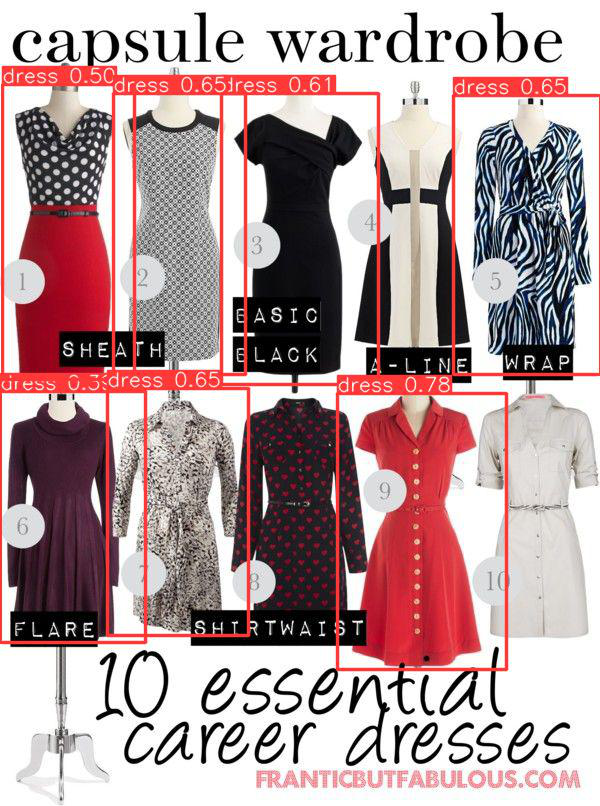

image 1/1: 2500x1667 1 dress
Speed: 64.4ms pre-process, 9.9ms inference, 1.2ms NMS per image at shape (1, 3, 640, 448)
Saved 1 image to /content


img.size = (1667, 2500)
[         xmin        ymin     xmax         ymax  confidence  class   name
0  442.386688  853.027283  1114.75  1968.749878    0.876953      0  dress]


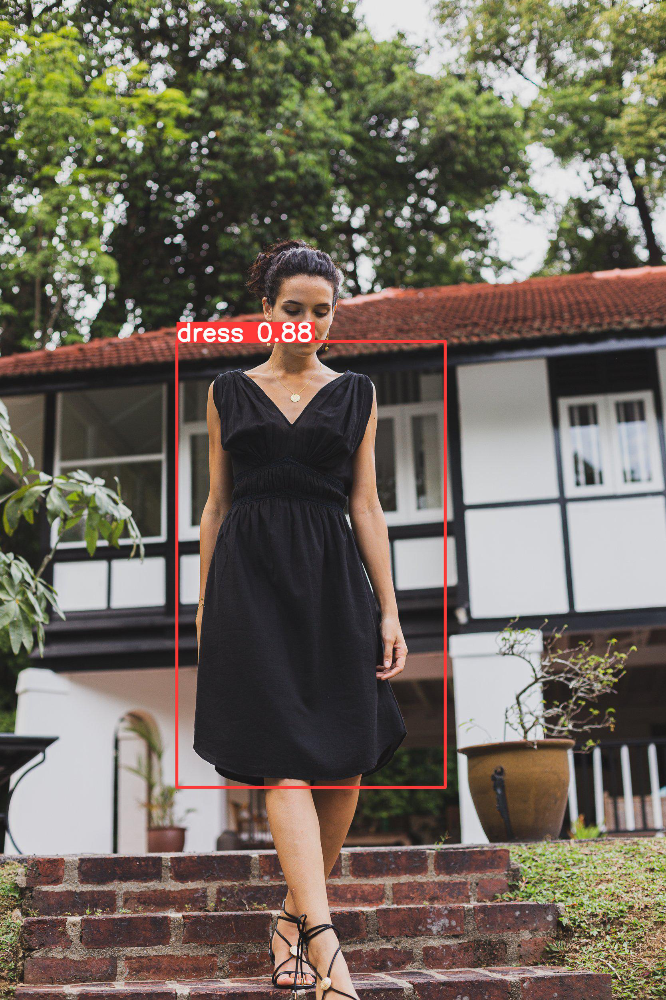

image 1/1: 2500x1667 1 dress
Speed: 66.3ms pre-process, 10.4ms inference, 1.2ms NMS per image at shape (1, 3, 640, 448)


img.size = (1667, 2500)


Saved 1 image to /content


[         xmin        ymin        xmax         ymax  confidence  class   name
0  430.667938  845.214783  1056.15625  2001.953003    0.917969      0  dress]


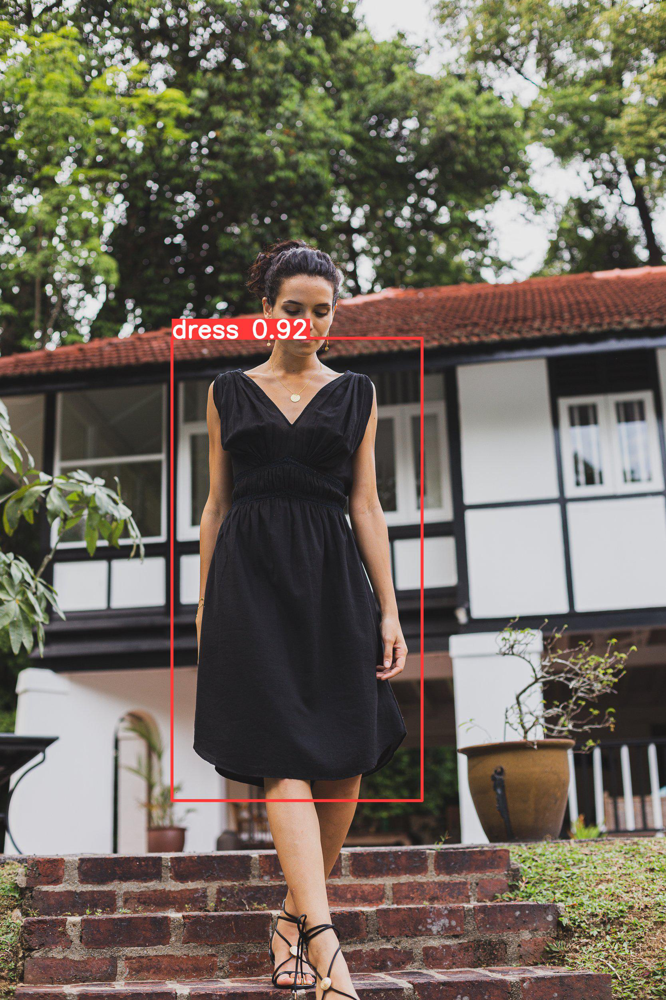

image 1/1: 700x1240 5 dresss
Speed: 28.0ms pre-process, 19.8ms inference, 1.9ms NMS per image at shape (1, 3, 384, 640)
Saved 1 image to /content


img.size = (1240, 700)
[         xmin        ymin         xmax        ymax  confidence  class   name
0  936.781250  156.128906  1136.343750  437.187500    0.667969      0  dress
1  396.218750  117.378906   575.921875  512.750000    0.606445      0  dress
2   45.046875  121.375000   268.585938  543.750000    0.277588      0  dress
3  731.406250  120.406250   963.906250  630.453125    0.255615      0  dress
4  227.535156  115.199219   444.171875  554.890625    0.251221      0  dress]


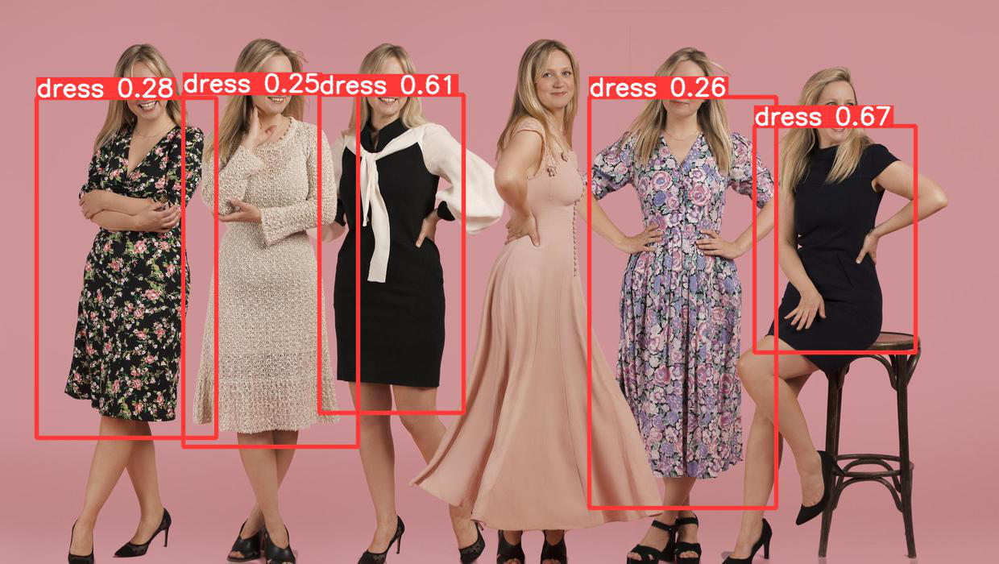

image 1/1: 700x1240 3 dresss
Speed: 121.7ms pre-process, 87.9ms inference, 9.6ms NMS per image at shape (1, 3, 384, 640)
Saved 1 image to /content


img.size = (1240, 700)
[         xmin        ymin         xmax        ymax  confidence  class   name
0   47.287109  130.457031   278.273438  538.421875    0.788574      0  dress
1  717.843750  133.363281  1009.437500  622.703125    0.464844      0  dress
2  383.382812  125.492195   587.546875  511.781281    0.229736      0  dress]


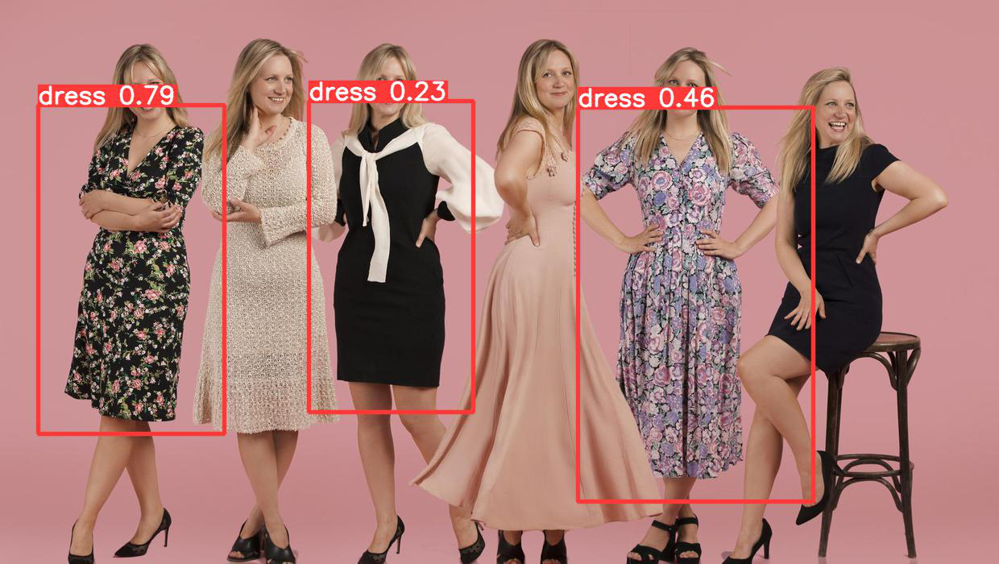

image 1/1: 896x587 (no detections)
Speed: 17.7ms pre-process, 12.7ms inference, 0.6ms NMS per image at shape (1, 3, 640, 448)
Saved 1 image to /content


img.size = (587, 896)
[Empty DataFrame
Columns: [xmin, ymin, xmax, ymax, confidence, class, name]
Index: []]


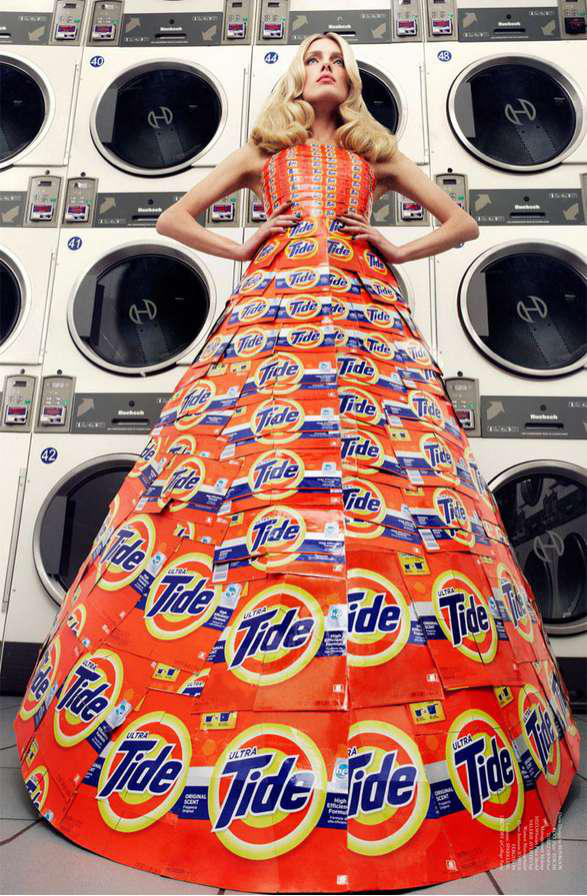

image 1/1: 896x587 (no detections)
Speed: 31.2ms pre-process, 17.9ms inference, 0.5ms NMS per image at shape (1, 3, 640, 448)
Saved 1 image to /content


img.size = (587, 896)
[Empty DataFrame
Columns: [xmin, ymin, xmax, ymax, confidence, class, name]
Index: []]


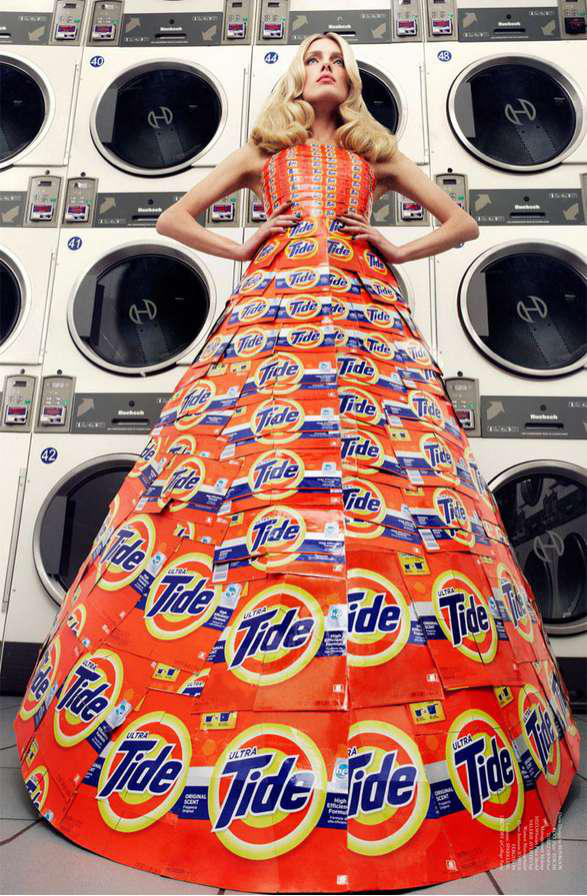

image 1/1: 1399x960 (no detections)
Speed: 59.6ms pre-process, 12.6ms inference, 0.6ms NMS per image at shape (1, 3, 640, 448)
Saved 1 image to /content


img.size = (960, 1399)
[Empty DataFrame
Columns: [xmin, ymin, xmax, ymax, confidence, class, name]
Index: []]


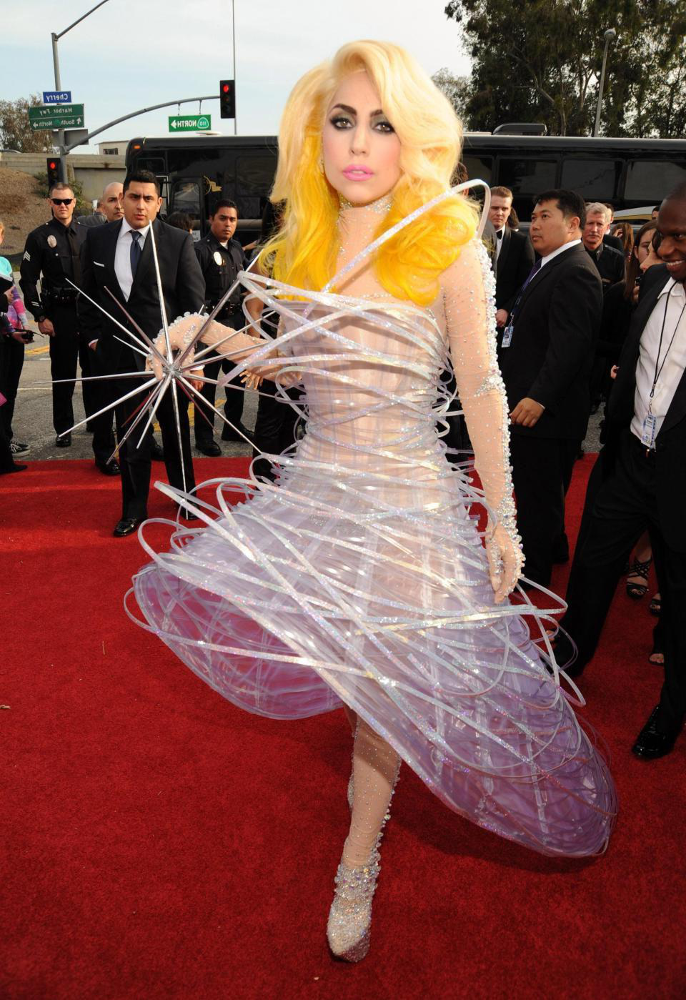

image 1/1: 1399x960 (no detections)
Speed: 53.1ms pre-process, 13.0ms inference, 0.6ms NMS per image at shape (1, 3, 640, 448)
Saved 1 image to /content


img.size = (960, 1399)
[Empty DataFrame
Columns: [xmin, ymin, xmax, ymax, confidence, class, name]
Index: []]


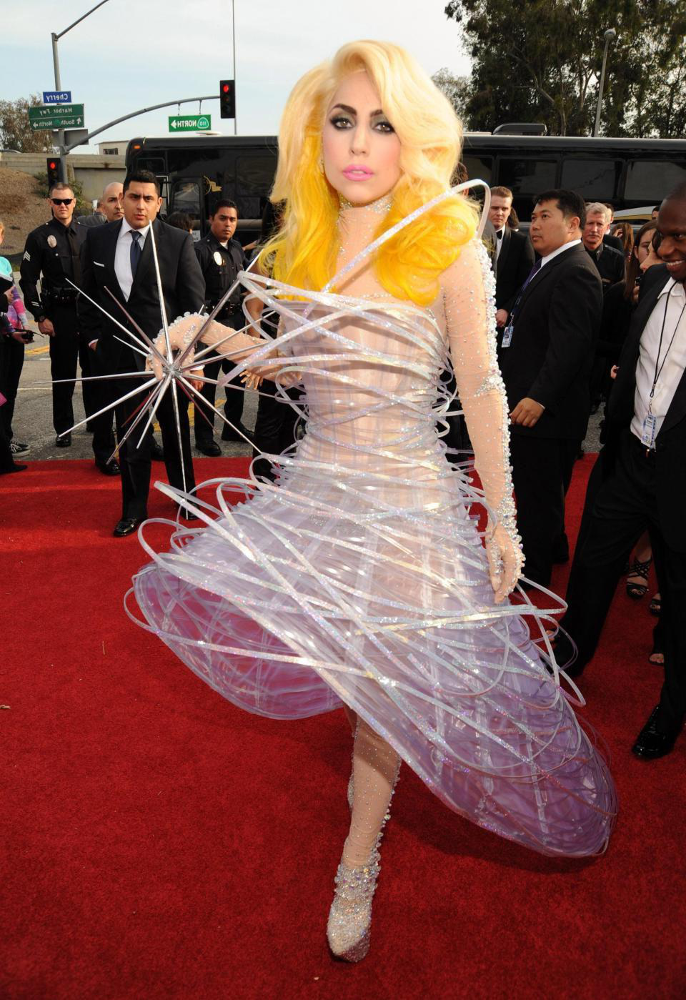

image 1/1: 259x194 1 dress
Speed: 4.6ms pre-process, 32.7ms inference, 1.5ms NMS per image at shape (1, 3, 640, 480)
Saved 1 image to /content


img.size = (194, 259)
[        xmin       ymin        xmax        ymax  confidence  class   name
0  76.360939  39.811134  143.943756  156.411728    0.747559      0  dress]


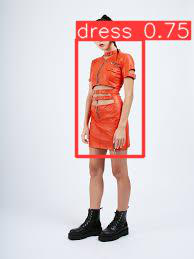

image 1/1: 259x194 1 dress
Speed: 5.5ms pre-process, 18.1ms inference, 1.4ms NMS per image at shape (1, 3, 640, 480)
Saved 1 image to /content


img.size = (194, 259)
[        xmin      ymin        xmax        ymax  confidence  class   name
0  79.294922  40.36758  141.414459  158.536331    0.856445      0  dress]


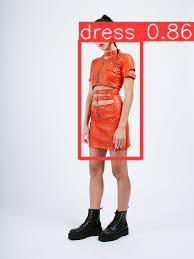

image 1/1: 1200x1200 (no detections)
Speed: 153.1ms pre-process, 15.8ms inference, 0.5ms NMS per image at shape (1, 3, 640, 640)
Saved 1 image to /content


img.size = (1200, 1200)
[Empty DataFrame
Columns: [xmin, ymin, xmax, ymax, confidence, class, name]
Index: []]


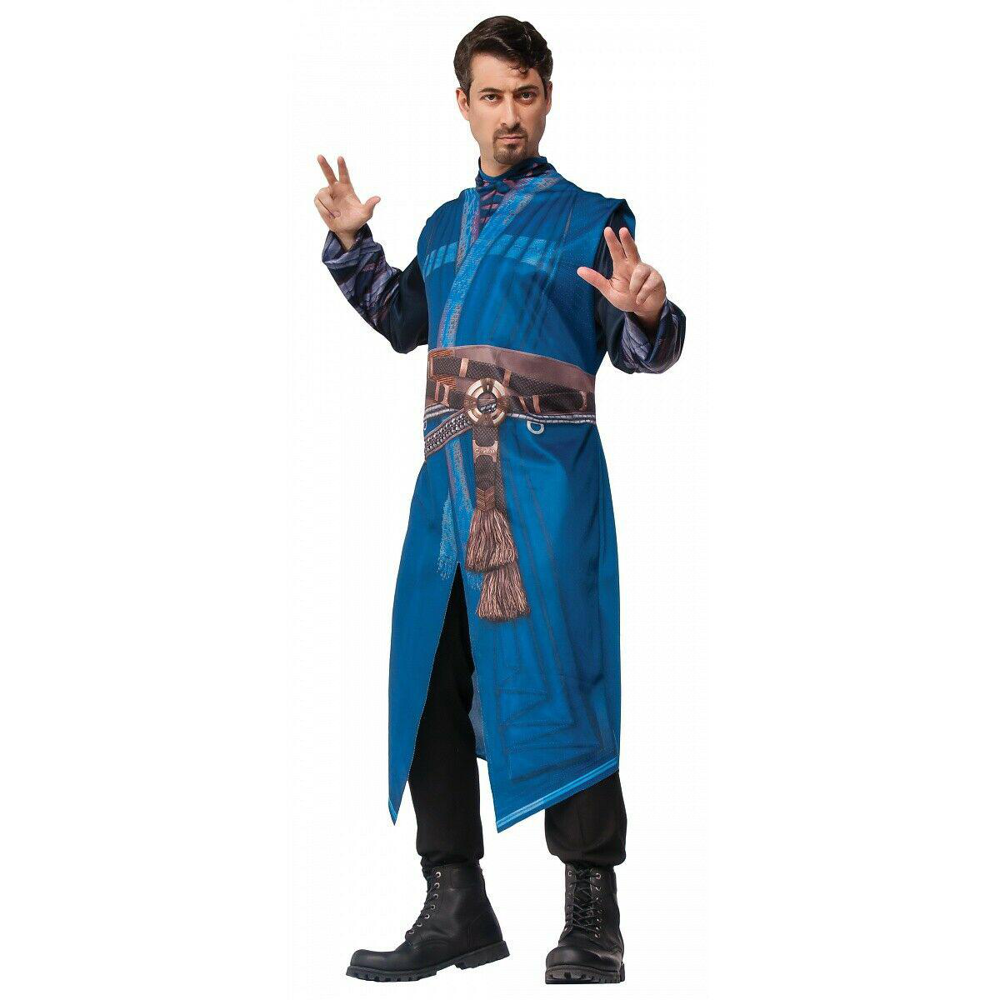

image 1/1: 1200x1200 1 dress
Speed: 48.4ms pre-process, 12.5ms inference, 1.7ms NMS per image at shape (1, 3, 640, 640)
Saved 1 image to /content


img.size = (1200, 1200)
[         xmin        ymin        xmax         ymax  confidence  class   name
0  329.062469  138.281235  817.499939  1093.124878    0.568359      0  dress]


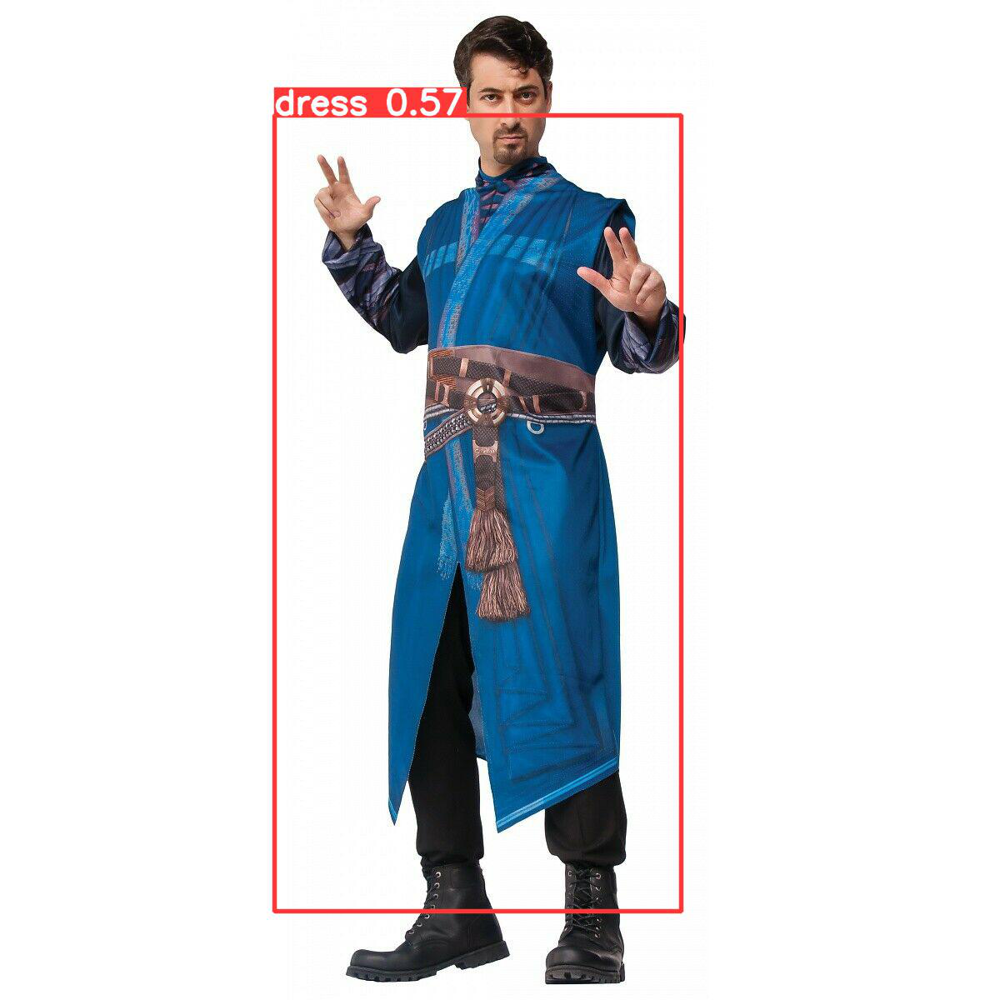

image 1/1: 168x300 2 dresss
Speed: 4.2ms pre-process, 37.4ms inference, 1.5ms NMS per image at shape (1, 3, 384, 640)
Saved 1 image to /content


img.size = (300, 168)
[         xmin       ymin        xmax       ymax  confidence  class   name
0   86.132805  28.804686  171.679672  167.90625    0.277588      0  dress
1  148.828110  23.355467  213.515610  164.15625    0.233521      0  dress]


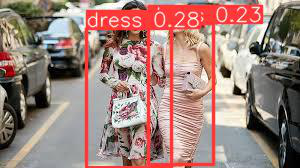

image 1/1: 168x300 1 dress
Speed: 4.1ms pre-process, 11.4ms inference, 1.4ms NMS per image at shape (1, 3, 384, 640)
Saved 1 image to /content


img.size = (300, 168)
[        xmin       ymin        xmax        ymax  confidence  class   name
0  84.140617  25.347654  195.937485  167.203125    0.725098      0  dress]


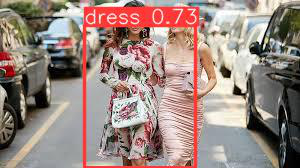

In [ ]:
links =  ['https://imgcdn.loverepublic.ru/upload/images/04503/thumb/600_9999/0450358537_1.jpg', 
          'https://img.buzzfeed.com/buzzfeed-static/static/2019-11/11/8/campaign_images/b9a22184558c/this-capsule-wardrobe-is-like-the-swiss-army-knif-2-692-1573459650-0_dblbig.jpg',
          'https://charlestonmag.com/IMG_4673.jpg',
           'https://i.pinimg.com/originals/f3/d2/05/f3d2054b34b9157c8620bbee9e6bf65e.jpg',
          'https://www.capsulebyjuliette.com/wp-content/uploads/2020/03/Eugenie-dress-black-lace-womens-fashion-capsule-by-juliette-1-1.jpg',
          'https://www.independent.ie/style/fashion/e0b73/40491929.ece/AUTOCROP/w1240h700/mg%20liadan_1',
          'https://theingazetteblog.files.wordpress.com/2013/05/unusual-couture2.jpg',
          'https://placepic.ru/wp-content/uploads/2018/06/nintchdbpict000409982732.jpg',
          'https://encrypted-tbn0.gstatic.com/images?q=tbn:ANd9GcRB9J-CyD0Qcox6fl0rmlHDQtih8ZqNe4UPeQ&usqp=CAU',
          'https://i.ebayimg.com/images/g/QAEAAOSwktlgxK5~/s-l1600.jpg',
          'https://encrypted-tbn0.gstatic.com/images?q=tbn:ANd9GcTQucaoFdFbefpyCe2VY8dlrIo_4Oz5UX078w&usqp=CAU']
for link in links:
  _,_ = predict_url_bbox(yolo320, link, True)
  _,_ = predict_url_bbox(yolo640, link, True)

**Conslusion:** by both learning result plots and detections, it seems like 640 YOLO has not trained enought. It misses some dresses and can't separate cases when several dresses are placed beside.  
Moreover, val and test folds of fashion-cv dataset are closer to 320, so it is rational to use 320.

**Decision:** use YOLO with 320 resize.

#4 RESNET 18 

The only reason why resnet-18 was chosen to project: it is the smalles by amount of parameters model, which is available in PyTorch zoo. 

## 4.1. Datasets definition

Datasets consists of dresses only. Other type of clothes are skipped.

In [ ]:
def show(imgs):
    if not isinstance(imgs, list):
        imgs = [imgs]
    fix, axs = plt.subplots(ncols=len(imgs), squeeze=False)
    for i, img in enumerate(imgs):
        img = img.detach()
        img = F.to_pil_image(img)
        axs[0, i].imshow(np.asarray(img))
        axs[0, i].set(xticklabels=[], yticklabels=[], xticks=[], yticks=[])

class DressDataset(Dataset):
    def __init__(self, filelist_path, category_path, attribites_path, image_folder, transform=None):
        
        # collect attrs and categories
        cate = pd.read_csv(category_path, header = None, names = ['cate']).apply(lambda x: x-1, axis = 0)
        attrs = pd.read_csv(attribites_path, header = None, names = ['attrs'])
        attrs = attrs['attrs'].map(lambda x: np.fromstring(x, sep = ' '))
        
        with open(filelist_path, 'r') as f:
          images = f.readlines()
        files = pd.Series(images, name = 'filepath').map(lambda name: name[:-1].replace('img/', '').replace('/', '_'))
        
        dataset_info = pd.concat([cate, attrs, files], axis = 1)
        
        # filter to get dresses only
        dataset_info = dataset_info[dataset_info.cate == 40]
        
        self.transform = transform
        self.filelist = dataset_info.filepath.values
        self.target = dataset_info['attrs'].values
        self.image_folder = image_folder

    def __len__(self):
        return len(self.filelist)

    def __getitem__(self, index):        
        path_image = os.path.join(self.image_folder, self.filelist[index])
  
        image = Image.open( path_image).convert('RGB')
        # image = read_image(path_image).type('torch.DoubleTensor') 
        # image = image

        labels = torch.Tensor(self.target[index])
          
        if self.transform: 
          image = self.transform(image)
          
        return image, labels, path_image

In [ ]:
trans = transforms.Compose([
  transforms.Resize((320, 320)),
  transforms.ToTensor(),
  transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225]), # imagenet
  transforms.RandomHorizontalFlip(p=0.2),
  transforms.RandomRotation(20),
])

train_dataset =  DressDataset(filelist_path = '/content/dataset/train.txt', category_path ='/content/dataset/train_cate.txt', 
                             attribites_path = '/content/dataset/train_attr.txt', image_folder = '/content/dataset/train/images', transform = trans)
val_dataset = DressDataset(filelist_path = '/content/dataset/val.txt', category_path ='/content/dataset/val_cate.txt', 
                             attribites_path = '/content/dataset/val_attr.txt', image_folder = '/content/dataset/val/images', transform = trans)
batch_size = 100

train_loader = DataLoader(train_dataset, batch_size=batch_size, drop_last=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, drop_last=True)

image, labels, path = train_dataset[45]
# show(image)
# display(image)
print(labels, path)

tensor([0., 0., 0., 0., 0., 1., 0., 0., 0., 1., 1., 0., 0., 0., 0., 0., 1., 0.,
        0., 1., 0., 0., 0., 0., 0., 1.]) /content/dataset/train/images/Twist-Back_Colorblocked_Dress_img_00000056.jpg


## 4.2. Training loop definition

In [ ]:
def train_model(model, train_loader, val_loader, loss, optimizer, scheduler, num_epochs, threshold, path):    
    '''
    train with exponential scheduler with gamma 0.95
    compute mean accuracy per sample, then average per samples using threshold
    threshold doesn't matter, it can be found after training, here just for info
    if both train loss and val loss are better than previous ones, save weights at path  
    '''
    
    loss_history_train = []
    loss_history_val = []
    train_history = []
    val_history = []

    model.to(device)
    sigmoid = nn.Sigmoid()

    best_loss = {'train': np.inf, 'val': np.inf}

    for epoch in range(num_epochs):
        model.train() # Enter train mode
        
        loss_accum = 0
        correct_attrs= 0
        total_attrs = 0
        for i_step, (x,y, _)  in enumerate(train_loader):
            x = x.to(device)
            y = y.to(device)
            

            prediction = model(x)    
            loss_value = loss(prediction, y)
            optimizer.zero_grad()
            loss_value.backward()
            optimizer.step()
            

            pred_attrs = torch.tensor((sigmoid(prediction)>threshold), dtype=torch.uint8)
            correct_attrs += torch.sum(pred_attrs == y)/y.shape[1]
            total_attrs += y.shape[0]
            
            loss_accum += float(loss_value)

        scheduler.step()
        ave_loss = loss_accum / i_step
        train_accuracy = float(correct_attrs) / total_attrs
        val_accuracy, val_loss = run_validation(model, val_loader,threshold)

        loss_history_train.append(float(ave_loss))
        loss_history_val.append(val_loss)
        train_history.append(train_accuracy)
        val_history.append(val_accuracy)

        
        if (path is not None) & (best_loss['train'] > ave_loss) & (best_loss['val'] > val_loss):
          make_weights_snapshot(epoch, model, optimizer, loss_value, path)
          best_loss['train'] = ave_loss 
          best_loss['val'] = val_loss
        print("Epoch {}. Average train loss: {}, Average val loss: {}, Train accuracy: {}, Val accuracy: {}".format(epoch, ave_loss, val_loss, train_accuracy, val_accuracy))
    
    return loss_history_train, loss_history_val, train_history, val_history

def make_weights_snapshot(epoch, model, optimizer, loss_value, path):
  path = path + 'resnet_best.pt'
  
  torch.save({
            'epoch': epoch,
            'model_state_dict': model.state_dict(),
            'optimizer_state_dict': optimizer.state_dict(),
            'loss': loss_value,
            }, path)
  print(f'The best weights snapshot done. Epoch: {epoch}')
          

def run_validation(model, loader, threshold):
    """
    Computes accuracy on the dataset wrapped in a loader
    
    Returns: accuracy as a float value between 0 and 1
    """
    model.eval() 

    sigmoid = nn.Sigmoid()
    total_attrs = 0
    correct_attrs = 0
    loss_accum = 0

    predictions_total = []
    ground_truth_total = []

    with torch.no_grad():
      for i_iter, (x, y, _) in enumerate(loader): 
          
          x = x.to(device)
          y = y.to(device)

          prediction = model(x)
          
          loss_value = loss(prediction, y)
          loss_accum += float(loss_value)
                      
          pred_attrs = torch.tensor((sigmoid(prediction)>threshold), dtype=torch.uint8)
          correct_attrs += torch.sum(pred_attrs == y)/y.shape[1]
          total_attrs += y.shape[0]
          # print(int(correct_attrs),total_attrs)
      ave_loss = float(loss_accum) / i_iter
      val_accuracy = float(correct_attrs) / total_attrs
    return val_accuracy, ave_loss


def visualise_training_results(train_accuracy, val_accuracy, parameters, type_of_input): 
    
    fig = plt.figure(figsize=(7,5))
    fig.suptitle('{} data for {} LR and decay parametesr'.format( type_of_input, parameters))
    # print('1')
    sns.lineplot( y = np.array(train_accuracy), 
                   x  = np.arange( len(train_accuracy)),
                 label = 'train'
           )
    # print('2')
    sns.lineplot( y =np.array(val_accuracy), 
                   x  = np.arange( len(val_accuracy)),
                 label = 'val'
               )

## 4.3.Load pretrained imagenet RESNET-18 and train it

#### 4.3.1. Find hyperparameters

Testing 0.0001 lr and 0.0001 decay...


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:27: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:74: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).


Epoch 0. Average train loss: 0.4835888621134636, Average val loss: 0.3762020468711853, Train accuracy: 0.7770193481445312, Val accuracy: 0.8162308349609375
Epoch 1. Average train loss: 0.27535735873075634, Average val loss: 0.3129544146358967, Train accuracy: 0.809451904296875, Val accuracy: 0.8282307739257813
Epoch 2. Average train loss: 0.21686983834474516, Average val loss: 0.28781208023428917, Train accuracy: 0.8332115478515625, Val accuracy: 0.8443846435546875
Epoch 3. Average train loss: 0.17515383813625726, Average val loss: 0.2770560309290886, Train accuracy: 0.8527884521484375, Val accuracy: 0.8565385131835938
Epoch 4. Average train loss: 0.14022863331513527, Average val loss: 0.27833110466599464, Train accuracy: 0.8712404174804688, Val accuracy: 0.863
Epoch 5. Average train loss: 0.11189440695139077, Average val loss: 0.29635293409228325, Train accuracy: 0.887923095703125, Val accuracy: 0.8643077392578125
Epoch 6. Average train loss: 0.09127071709969105, Average val loss: 0.2

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:121: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:121: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:121: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warnin

CPU times: user 2h 57min 15s, sys: 8min 30s, total: 3h 5min 45s
Wall time: 3h 5min 11s


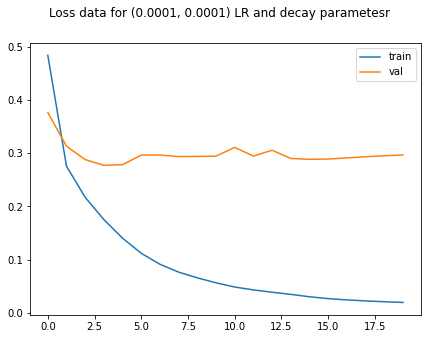

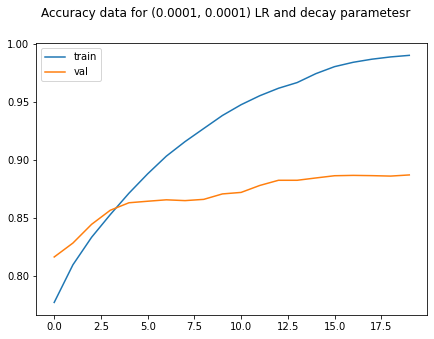

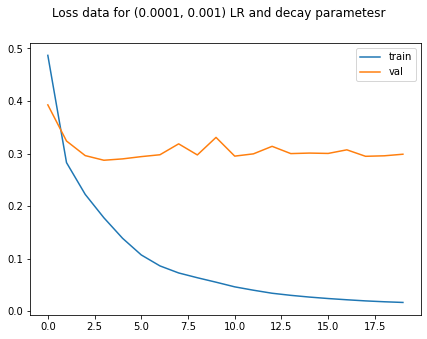

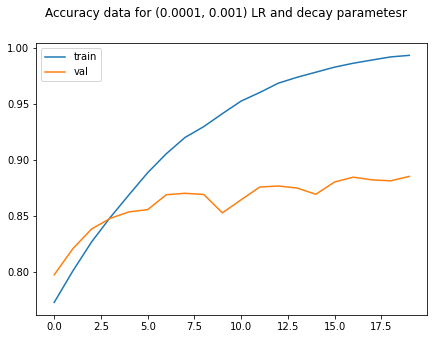

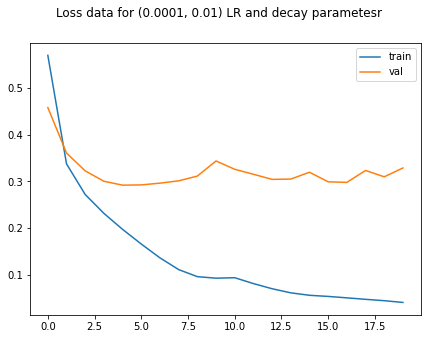

...

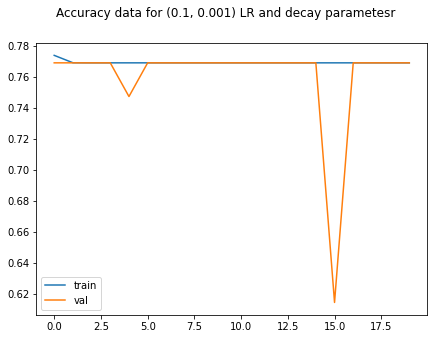

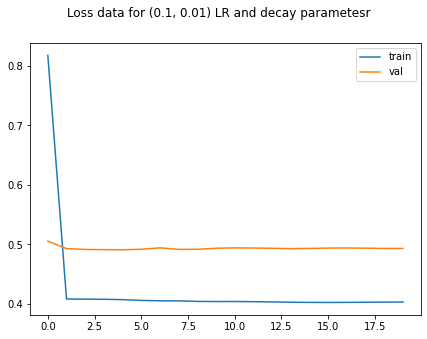

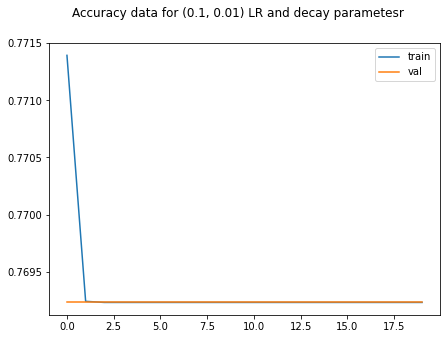

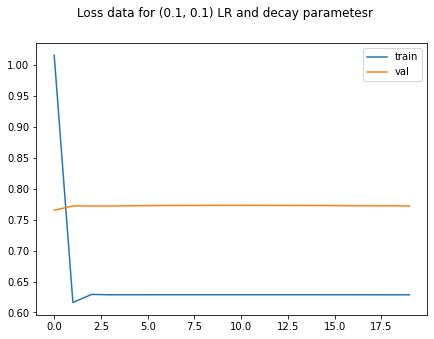

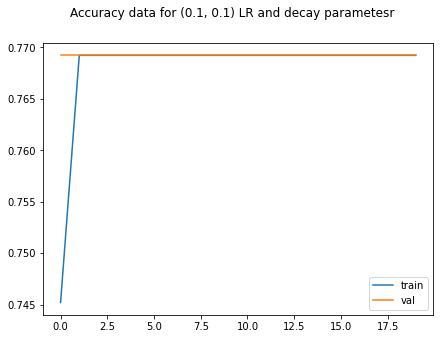

In [ ]:
%%time
from itertools import product

lrs = [1e-4, 1e-3, 1e-2, 1e-1]
decays = [1e-4, 1e-3, 1e-2, 1e-1]

parameters = list(product(lrs, decays))

loss_history_train_total = []
loss_history_val_total = []
train_history_total = []
val_history_total = []

for lr, decay in parameters:
  print(f'Testing {lr} lr and {decay} decay...')
  model = models.resnet18(pretrained=True)
  model.fc = nn.Linear(512, 26)

  optimizer = optim.Adam(model.parameters(), lr=lr, weight_decay = decay)
  scheduler = optim.lr_scheduler.ExponentialLR(optimizer, gamma=0.95)
  epochs_num = 20
  proba_threshold = 0.9
  device = 'cuda'
  loss = nn.BCEWithLogitsLoss()

  loss_history_train, loss_history_val, train_history, val_history = train_model(model, train_loader, val_loader,  
                                                                                loss,  optimizer, scheduler, epochs_num, proba_threshold)
  
  loss_history_train_total.append(loss_history_train)
  loss_history_val_total.append(loss_history_val)
  train_history_total.append(train_history)
  val_history_total.append(val_history)

# visualize training results
for idx in range(len(parameters)):
  visualise_training_results(loss_history_train_total[idx], loss_history_val_total[idx], parameters[idx], 'Loss')
  visualise_training_results(train_history_total[idx], val_history_total[idx], parameters[idx],  'Accuracy')

Only LR 1e-4 and decay 1-e1 looks good enough, let's try 1e-5 and 1-e1 in addition.

Testing 1e-05 lr and 0.1 decay...


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:36: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:94: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).


Epoch 0. Average train loss: 0.657325817988469, Average val loss: 0.7691869288682938, Train accuracy: 0.7692212524414063, Val accuracy: 0.7692308349609375
Epoch 1. Average train loss: 0.6154310993659191, Average val loss: 0.7246126383543015, Train accuracy: 0.7692116088867188, Val accuracy: 0.7692308349609375
Epoch 2. Average train loss: 0.5820945180379428, Average val loss: 0.6886100620031357, Train accuracy: 0.7692212524414063, Val accuracy: 0.7692308349609375
Epoch 3. Average train loss: 0.5552765497794518, Average val loss: 0.6594744026660919, Train accuracy: 0.7692308959960937, Val accuracy: 0.7692308349609375
Epoch 4. Average train loss: 0.5334164943450537, Average val loss: 0.6354925036430359, Train accuracy: 0.7692308959960937, Val accuracy: 0.7692308349609375
Epoch 5. Average train loss: 0.5153576693473718, Average val loss: 0.6154751777648926, Train accuracy: 0.7692308959960937, Val accuracy: 0.7692308349609375
Epoch 6. Average train loss: 0.5002658199041318, Average val loss

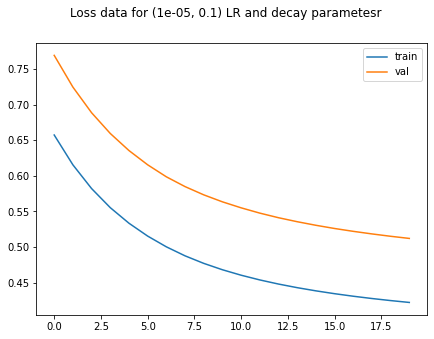

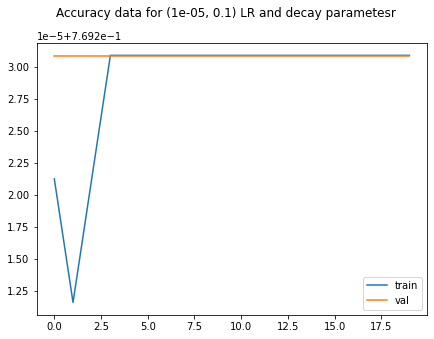

In [ ]:
%%time
from itertools import product

lrs = [1e-5]
decays = [ 1e-1]

parameters = list(product(lrs, decays))

loss_history_train_total = []
loss_history_val_total = []
train_history_total = []
val_history_total = []

for lr, decay in parameters:
  print(f'Testing {lr} lr and {decay} decay...')
  model = models.resnet18(pretrained=True)
  model.fc = nn.Linear(512, 26)

  optimizer = optim.Adam(model.parameters(), lr=lr, weight_decay = decay)
  scheduler = optim.lr_scheduler.ExponentialLR(optimizer, gamma=0.95)
  epochs_num = 20
  proba_threshold = 0.9
  device = 'cuda'
  loss = nn.BCEWithLogitsLoss()

  loss_history_train, loss_history_val, train_history, val_history = train_model(model, train_loader, val_loader,  
                                                                                loss,  optimizer, scheduler,
                                                                                 epochs_num, proba_threshold, None)
  
  loss_history_train_total.append(loss_history_train)
  loss_history_val_total.append(loss_history_val)
  train_history_total.append(train_history)
  val_history_total.append(val_history)

# visualize training results
for idx in range(len(parameters)):
  visualise_training_results(loss_history_train_total[idx], loss_history_val_total[idx], parameters[idx], 'Loss')
  visualise_training_results(train_history_total[idx], val_history_total[idx], parameters[idx],  'Accuracy')

Accuracy doesn't improve. lr = 1e-4
weight_decay = 1e-1 are selected

**Conclusion:** LR 1e-4 and decay 1-e1 were selected.

#### 4.3.2. Train with selected hyperparameters

In [ ]:
from torchvision import models
model = models.resnet18(pretrained=True)
model.fc = nn.Linear(512, 26)

lr = 1e-4
weight_decay = 1e-1

optimizer = optim.Adam(model.parameters(), lr=lr, weight_decay = weight_decay)
scheduler = optim.lr_scheduler.ExponentialLR(optimizer, gamma=0.95)
epochs_num = 100
proba_threshold = 0.9
best_weights_path = '/content/drive/MyDrive/resnet/'
device = 'cuda'
loss = nn.BCEWithLogitsLoss()

loss_history_train, loss_history_val, train_history, val_history = train_model(model, train_loader, val_loader,  
                                                                                loss,  optimizer, scheduler, 
                                                                               epochs_num, proba_threshold, best_weights_path)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:37: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:101: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).


The best weights snapshot done. Epoch: 0
Epoch 0. Average train loss: 0.5392735936702826, Average val loss: 0.5313943400979042, Train accuracy: 0.7692308959960937, Val accuracy: 0.7692308349609375
The best weights snapshot done. Epoch: 1
Epoch 1. Average train loss: 0.4145005131379152, Average val loss: 0.47736806422472, Train accuracy: 0.7692597045898437, Val accuracy: 0.7692308349609375
The best weights snapshot done. Epoch: 2
Epoch 2. Average train loss: 0.38499853702691883, Average val loss: 0.44969430565834045, Train accuracy: 0.7692789306640625, Val accuracy: 0.7695385131835938
The best weights snapshot done. Epoch: 3
Epoch 3. Average train loss: 0.3653270586943015, Average val loss: 0.42992109060287476, Train accuracy: 0.7694423217773437, Val accuracy: 0.7696153564453125
The best weights snapshot done. Epoch: 4
Epoch 4. Average train loss: 0.34873660711141735, Average val loss: 0.4133967086672783, Train accuracy: 0.769798095703125, Val accuracy: 0.7703847045898438
The best weigh

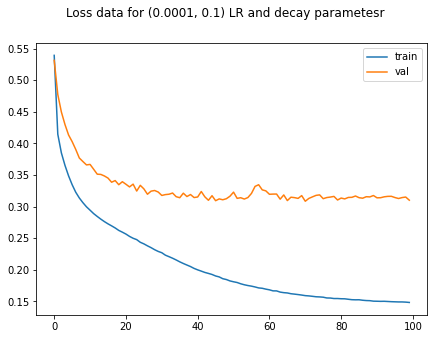

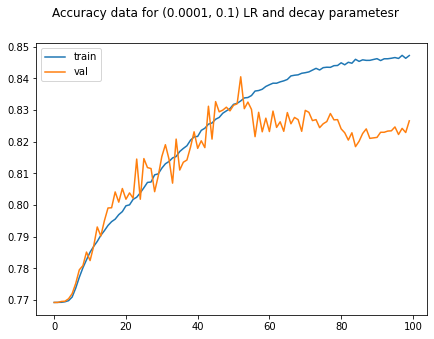

In [ ]:
visualise_training_results(loss_history_train, loss_history_val, (lr, weight_decay), 'Loss')
visualise_training_results(train_history, val_history, (lr, weight_decay),  'Accuracy')

Rollback to the best weights

In [ ]:
# rollback to best checkpoint after training and save for futher usage as a standalone model
model = models.resnet18(pretrained=True)
model.fc = nn.Linear(512, 26)
optimizer = optim.Adam(model.parameters(), lr=lr, weight_decay = weight_decay)

checkpoint = torch.load(best_weights_path+'resnet_best.pt')

model.load_state_dict(checkpoint['model_state_dict'])
optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
epoch = checkpoint['epoch']
loss = checkpoint['loss']

model.eval()

torch.save(model, '/content/drive/MyDrive/resnet/resnet18.model')

Real accuracy doesn't bother us, so we won't calculate it and chose thresholds for multilabel.

## 4.4. Create embeddings database

Load trained resnet, change last layer to get embedding instead of classes

In [ ]:
# change the last layer to get 512 flat embeddings
class Identity(nn.Module):
    def __init__(self):
        super(Identity, self).__init__()
        
    def forward(self, x):
        return x

device = 'cuda'

model = torch.load('/content/drive/MyDrive/resnet/resnet18.model')
model.fc = Identity()
model.to(device)

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
  

Create embeddings as is (only one per dress) for the sake of simplification.

In [ ]:
trans = transforms.Compose([
  transforms.Resize((320, 320)),
  transforms.ToTensor(),
  transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225]), # imagenet
  # transforms.RandomHorizontalFlip(p=0.2),
  # transforms.RandomRotation(20),
])
train_dataset =  DressDataset(filelist_path = '/content/dataset/train.txt', category_path ='/content/dataset/train_cate.txt', 
                             attribites_path = '/content/dataset/train_attr.txt', image_folder = '/content/dataset/train/images', transform = trans)
train_loader = DataLoader(train_dataset, batch_size=100, drop_last=True)

In [ ]:
%%time
embeddings_total = []
filenames_total = []
target_total = []
model.eval()
with torch.no_grad():
  for idx, (x,y,filename) in enumerate(train_loader):
    x = x.to(device)
    filename = pd.Series(filename)
    embedding = model(x)
    embeddings_total.append(embedding)
    filenames_total.append(filename)
    target_total.append(y)

/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /pytorch/c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)


CPU times: user 20.3 s, sys: 2.21 s, total: 22.5 s
Wall time: 22.9 s


In [ ]:
%%time
# convert to np to normalize
embeddings_total = torch.cat(embeddings_total, 0 ).cpu().detach().numpy()
embeddings_total = normalize(embeddings_total, norm='l2', axis=0, copy=True, return_norm=False)
embeddings_total_series = pd.Series(embeddings_total.tolist(), name = 'embedding')
# embeddings_total = embeddings_total.map(lambda x: np.array(x))

filenames_total = pd.concat(filenames_total, 0).reset_index(drop = True)
filenames_total.name = 'filename'
embeddings = pd.concat([embeddings_total_series, filenames_total], axis = 1)

target_total = torch.cat(target_total, 0 ).cpu().detach().numpy()
assert embeddings_total.shape[0], target_total.shape[0]

CPU times: user 153 ms, sys: 54.6 ms, total: 207 ms
Wall time: 320 ms


In [ ]:
embeddings.head(2)

,embedding,filename
0,"[0.039550382643938065, 0.0004625158617272973, ...",/content/dataset/train/images/Strapless_Diamon...
1,"[0.0007324975449591875, 0.003275111084803939, ...",/content/dataset/train/images/Abstract_Chevron...


Save train dataset embeddings for futher use as an available item database

In [ ]:
with open('/content/drive/MyDrive/resnet/embeddings.pickle', 'wb') as f:
  pickle.dump(embeddings_total, f)

Copy all images to the same folder to use in standalone eval phase to show

In [ ]:
!mkdir /content/imagedb
!mkdir /content/drive/MyDrive/imagedb
for idx, path in enumerate(filenames_total):
  copy(path, f'/content/imagedb/{idx}.jpg')
if os.path.exists('/content/drive/MyDrive/imagedb'):
  copy_tree('/content/imagedb', '/content/drive/MyDrive/imagedb')

## 4.5. Check embeddings similarity at images

In [ ]:
similarity_threshold = 0.95
dbfloder = '/content/drive/MyDrive/imagedb/'

def get_image_similarity(query_embedding, database_embeddings):
  '''
    calculate similarity of given embeddings with other pictures
  '''
  # get cosine similarity
  similarity = cosine_similarity(query_embedding, database_embeddings).reshape(-1)
  # sort and get index to show
  similarity_result =  pd.Series(similarity)
  return similarity_result

def show_similar_images(query_picture_num, num_to_show,  similarity_threshold, dbfloder, embeddings_total):
  '''
    show similari images from "database" folder, usuing cosine similarity matrix
  '''
  images = []
  similarity_result = get_image_similarity(embeddings_total[query_picture_num].reshape(1,-1), embeddings_total)
  
  # select only only above threshold
  index_to_show  = similarity_result[similarity_result > similarity_threshold].sort_values(ascending = False)[:num_to_show].index
 
  # show similar images ordered
  for img_name in index_to_show:  
    img = Image.open(f'{dbfloder}{img_name}.jpg')
    
    # to mosaic convert to (batch_size, channels, h, w)
    im_resized = img.resize((120, 120))
    np_img = np.array(im_resized)
    np_img = np.expand_dims(np_img,0)
    np_img = np.transpose(np_img, (0, 3, 1,2))
    images.append(np_img)

    mosaic = mosaic_images(np.concatenate(images, 0))
    mosaic = Image.fromarray(mosaic)
  return mosaic

def mosaic_images(images, max_size=1920, max_subplots=16):
    '''
      collects from numpy (batch_size, channels, h, w) single numpy image
      return PIL image
    '''
    # Plot image grid with labels
    if isinstance(images, torch.Tensor):
        images = images.cpu().float().numpy()

    if np.max(images[0]) <= 1:
        images *= 255.0  # de-normalise (optional)
    bs, _, h, w = images.shape  # batch size, _, height, width
    bs = min(bs, max_subplots)  # limit plot images
    ns = np.ceil(bs ** 0.5)  # number of subplots (square)

    # Build Image
    mosaic = np.full((int(ns * h), int(ns * w), 3), 255, dtype=np.uint8)  # init
    for i, im in enumerate(images):
        if i == max_subplots:  # if last batch has fewer images than we expect
            break
        x, y = int(w * (i // ns)), int(h * (i % ns))  # block origin
        im = im.transpose(1, 2, 0)
        mosaic[y:y + h, x:x + w, :] = im
        
    # Resize (optional)
    scale = max_size / ns / max(h, w)
    if scale < 1:
        h = math.ceil(scale * h)
        w = math.ceil(scale * w)
        mosaic = cv2.resize(mosaic, tuple(int(x * ns) for x in (w, h)))
    return mosaic

Plot images

1 iteration 


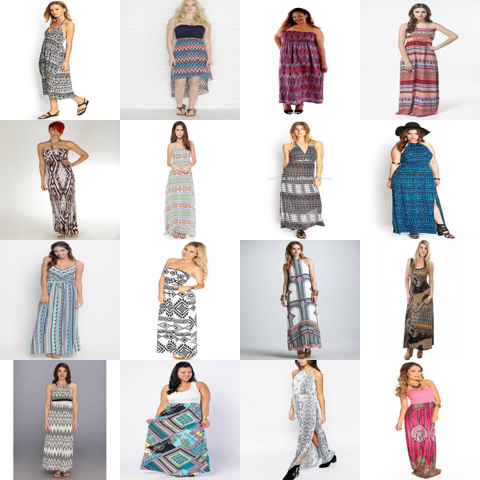

2 iteration 


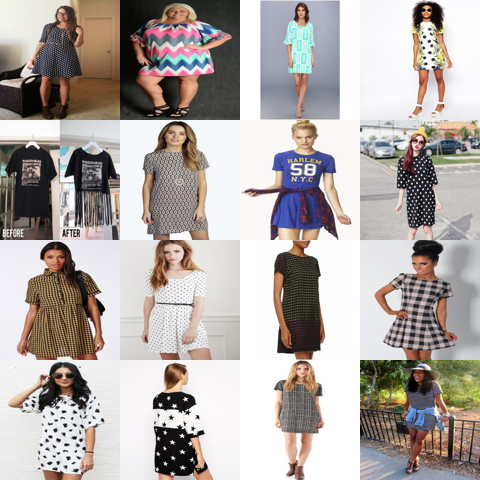

3 iteration 


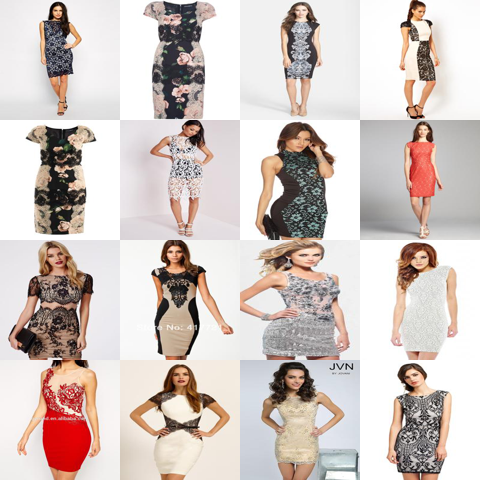

4 iteration 


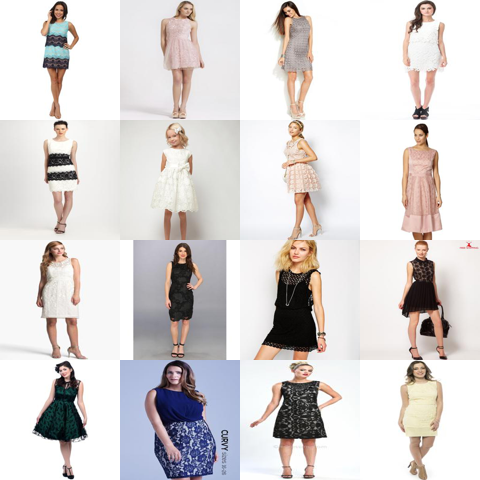

5 iteration 


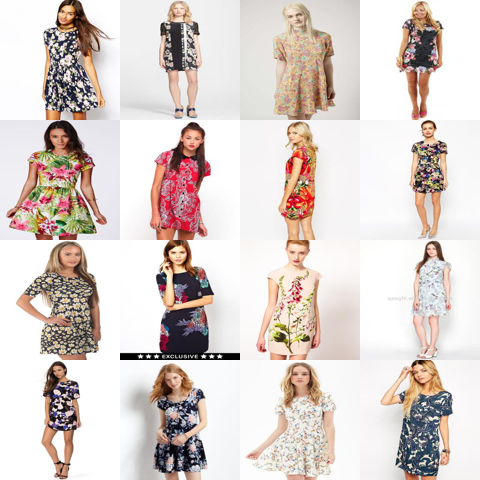

In [ ]:
for i in range(5):
  print(f"{i+1} iteration \n {f'='*10}")
  image_number = random.randint(0,3999)
  mosaic = show_similar_images(image_number, 16,  0.8, dbfloder, embeddings_total )
  display(mosaic)

**Conclusion:** seems that it works well.
**Decision:** combine YOLO output with Resnet.

#5 Combining YOLO with Resnet

## A problem with similarity for cropped image detected

Functions:

In [ ]:
# copy and run prototype functions
def predict_bbox(model, img, image_size):
  '''run yolo
    return PIL image and bbox
  '''
  result = model(img, image_size)
  result.save('buffer')
  img_detected = Image.open('buffer/'+ os.path.basename(img.filename))
  return img_detected, result.pandas().xyxy[0]

def crop_dresses(img, result):
  '''
    takes source image and reult from predict_bbox function
  '''
  recognized_dresses = []
  for row_idx in result.index:
    bbox_coordinates = result.iloc[row_idx, :].values[:4]
    confidence = result.iloc[row_idx, :].values[4]
    cropped_img = img.crop(bbox_coordinates)
    cropped_img.show()
    recognized_dresses.append(cropped_img)
  return recognized_dresses

def get_embeddings(images, model, trans):
  '''
    images - PIL image list, model - resnet
    return - list of [512] embeddings
  '''
  # convert_tensor = transforms.ToTensor()
  embeddings = []
  for img in images:
    img = torch.unsqueeze(trans(img), 0).to(device)
    embeddings.append(model(img)) 
  return embeddings

def get_image_similarity_cuda(query_embedding, database_embeddings):
  '''
    query_embedding - embedding of the picture using in the search
    database_embeddings - embeddings in database from train dataset
    one embedding per run
  '''
  # get cosine similarity
  similarity = cosine_similarity(query_embedding.cpu().detach().numpy(), database_embeddings).reshape(-1)

  # sort and get index to show
  similarity_result =  pd.Series(similarity)
  return similarity_result

def get_similar_images_cuda(query_embedding, num_to_show,  similarity_threshold, dbfloder, embeddings_total_cropped):
  '''
    Find similar embeddings in local database, read similar images from 'database', response mosaic, built with mosaic_images
  '''
  images = []
  similarity_result = get_image_similarity_cuda(query_embedding.reshape(1,-1), embeddings_total_cropped)
  # select only only above threshold
  index_to_show  = similarity_result[similarity_result > similarity_threshold].sort_values(ascending = False)[:num_to_show].index
  print(index_to_show)
  #nothing was found
  if len(index_to_show) == 0:
    return -1  
  # show similar images ordered
  for img_name in index_to_show:
    # print(f'Showing images{dbfloder}{img_name}.jpg')
    img = Image.open(f'{dbfloder}{img_name}.jpg')
    
    # to mosaic convert to (batch_size, channels, h, w)
    im_resized = img.resize((120, 120))
    np_img = np.array(im_resized)
    np_img = np.expand_dims(np_img,0)
    np_img = np.transpose(np_img, (0, 3, 1,2))
    images.append(np_img)

    mosaic = mosaic_images(np.concatenate(images, 0))
    mosaic = Image.fromarray(mosaic)
    # .resize((1920,1920), 2)
  return mosaic

def mosaic_images(images, max_size=1920, max_subplots=16):
    '''
      collects from numpy (batch_size, channels, h, w) single numpy image
    '''
    # Plot image grid with labels
    if isinstance(images, torch.Tensor):
        images = images.cpu().float().numpy()

    if np.max(images[0]) <= 1:
        images *= 255.0  # de-normalise (optional)
    bs, _, h, w = images.shape  # batch size, _, height, width
    bs = min(bs, max_subplots)  # limit plot images
    ns = np.ceil(bs ** 0.5)  # number of subplots (square)

    # Build Image
    mosaic = np.full((int(ns * h), int(ns * w), 3), 255, dtype=np.uint8)  # init
    for i, im in enumerate(images):
        if i == max_subplots:  # if last batch has fewer images than we expect
            break
        x, y = int(w * (i // ns)), int(h * (i % ns))  # block origin
        im = im.transpose(1, 2, 0)
        mosaic[y:y + h, x:x + w, :] = im

    # Resize (optional)
    scale = max_size / ns / max(h, w)
    if scale < 1:
        h = math.ceil(scale * h)
        w = math.ceil(scale * w)
        mosaic = cv2.resize(mosaic, tuple(int(x * ns) for x in (w, h)))
    return mosaic

Load trained YOLO and resnet

In [ ]:
copy( '/content/drive/MyDrive/yolo_weights/dress_only_best_300.pt', 'yolo320.pt')
model = torch.hub.load('ultralytics/yolov5', 'custom', path='yolo320.pt', force_reload = False)
model.conf = 0.2  # like it was trained
model.iou = 0.2 # like it was trained
image_size = 320

resnet = torch.load('/content/drive/MyDrive/resnet/resnet18.model')
resnet.fc = Identity()
resnet.to('cuda')

Downloading: "https://github.com/ultralytics/yolov5/archive/master.zip" to /root/.cache/torch/hub/master.zip


requirements: PyYAML>=5.3.1 not found and is required by YOLOv5, attempting auto-update...


YOLOv5 🚀 2021-11-8 torch 1.9.0+cu111 CUDA:0 (Tesla P100-PCIE-16GB, 16281MiB)



  Attempting uninstall: PyYAML
    Found existing installation: PyYAML 3.13
    Uninstalling PyYAML-3.13:
      Successfully uninstalled PyYAML-3.13

requirements: 1 package updated per /root/.cache/torch/hub/ultralytics_yolov5_master/requirements.txt
requirements: ⚠️ Restart runtime or rerun command for updates to take effect



Fusing layers... 
Model Summary: 224 layers, 7053910 parameters, 0 gradients
Adding AutoShape... 


ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
  

Similarity at embeddings only (withoout croppping):

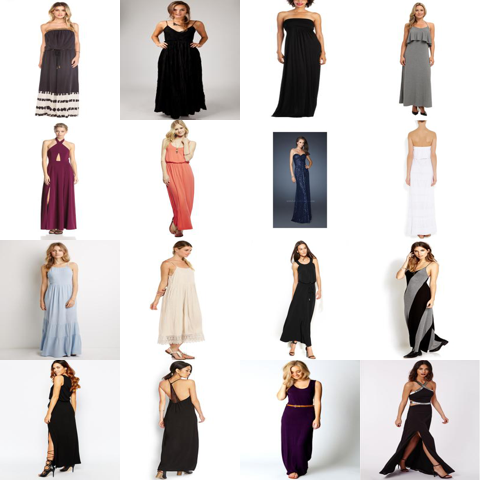

In [ ]:
mosaic = show_similar_images(14, 16,  0.8, dbfloder, embeddings_total)
display(mosaic)

Similarity for the YOLO cropped and Resnet pipeline:

Saved 1 image to buffer


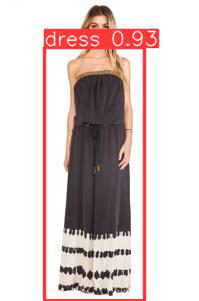

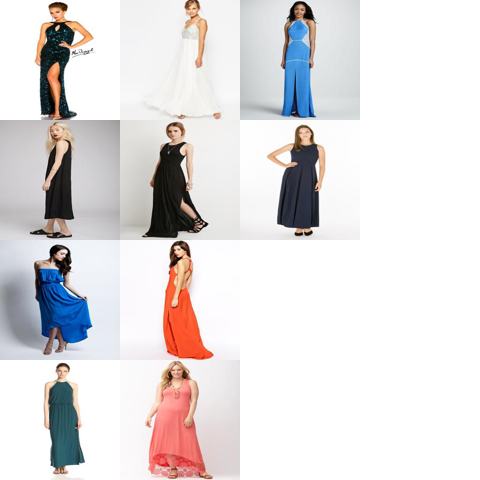

In [ ]:
trans = transforms.Compose([
  transforms.Resize((320, 320)),
  transforms.ToTensor(),
  transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225]), # imagenet
])

img = Image.open("/content/drive/MyDrive/imagedb/14.jpg")
# display(img)

img_bbox, bbox = predict_bbox(model, img, image_size)    
display(img_bbox)
# print(img_bbox.size)
recognized_dresses = crop_dresses(img, bbox) 
embeddings= []
embeddings = get_embeddings( recognized_dresses,resnet, trans)

# print(len(embeddings))

mosaic_list=[] 

for emb in embeddings:
  mosaic = get_similar_images_cuda(emb, 10,  0.8, '/content/drive/MyDrive/imagedb/', embeddings_total)
  mosaic_list.append(mosaic)
display(mosaic_list[0])

Checking for the cosine similarity of cropped and uncropped images:

In [ ]:
cropped_img = torch.tensor(np.array(recognized_dresses[0])).unsqueeze(0).permute(0, 3, 1, 2).type(torch.FloatTensor).to(device)
cropped_embediing = resnet(cropped_img).cpu().detach().numpy()
uncropped_embedding = embeddings_total[14].reshape(1, -1)
print(f'Cosine similarity for cropped and uncropped is {cosine_similarity(cropped_embediing, uncropped_embedding)}')

Cosine similarity for cropped and uncropped is [[    0.30048]]


**Conclusion:** 
1. Similarity is different for cropped and uncropped images.
2. Seems like resnet resize in transforms kills the ability to recognise the similarity for cropped images. Scale factor to big. 
2. Pipeline doesn't work.

**Decision:** train resnet on cropped images in order to get similarity search working after YOLO.

#6 Training renset on cropped images and check pipeline again

## 6.1. Create cropped dataset

Create datasets, based on annotation boundary boxed.

In [ ]:
# dataset changed to return cropped images
class DressCroppesDataset(Dataset):
    def __init__(self, filelist_path, category_path, attribites_path, annotations_path, image_folder, transform=None):
        
        # collect attrs and categories
        cate = pd.read_csv(category_path, header = None, names = ['cate']).apply(lambda x: x-1, axis = 0)
        attrs = pd.read_csv(attribites_path, header = None, names = ['attrs'])
        attrs = attrs['attrs'].map(lambda x: np.fromstring(x, sep = ' '))
        
        with open(filelist_path, 'r') as f:
          images = f.readlines()
        files = pd.Series(images, name = 'filepath').map(lambda name: name[:-1].replace('img/', '').replace('/', '_'))
        
        df_anno = pd.read_csv(annotations_path, 
                              delim_whitespace=True, header = None, names = ['category', 'x', 'y', 'w', 'h'])

        dataset_info = pd.concat([cate, attrs, files, df_anno], axis = 1)
        dataset_info['bbox'] = dataset_info.apply(lambda row: [row.x, row.y, row.w, row.h], axis = 1)

        # filter to get dresses only
        dataset_info = dataset_info[dataset_info.cate == 40]
        
        self.transform = transform
        self.filelist = dataset_info.filepath.values

        self.target = dataset_info['attrs'].values
        self.image_folder = image_folder
        self.boundaries = dataset_info['bbox'].values

    def __len__(self):
        return len(self.filelist)

    def __getitem__(self, index):        
        path_image = os.path.join(self.image_folder, self.filelist[index])
  
        image = Image.open( path_image).convert('RGB')
        # crop bbox
        bbox = self.boundaries[index]
        x,y = image.size
        x1 = np.round(x*bbox[0] - x*bbox[2]/2)
        y1 = np.round(y*bbox[1] - y*bbox[3]/2)
        x2 = np.round(x*bbox[0] + x*bbox[2]/2)
        y2 = np.round(y*bbox[1] + y*bbox[3]/2)
        image = image.crop((x1, y1, x2, y2))
        # print(image.size)
        labels = torch.Tensor(self.target[index])          
        if self.transform: 
          image = self.transform(image)
          
        return image, labels, path_image

trans = transforms.Compose([
  transforms.Resize((125, 225)),
  transforms.ToTensor(),
  transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225]), # imagenet
  transforms.RandomHorizontalFlip(p=0.2),
  transforms.RandomRotation(20),
])

train_dataset =  DressCroppesDataset(filelist_path = '/content/dataset/train.txt', category_path ='/content/dataset/train_cate.txt', 
                             attribites_path = '/content/dataset/train_attr.txt', 
                             annotations_path = '/content/dataset/train_annotations.txt', image_folder = '/content/dataset/train/images', transform = trans)
val_dataset = DressCroppesDataset(filelist_path = '/content/dataset/val.txt', category_path ='/content/dataset/val_cate.txt', 
                             attribites_path = '/content/dataset/val_attr.txt', 
                             annotations_path = '/content/dataset/val_annotations.txt', image_folder = '/content/dataset/val/images', transform = trans)
batch_size = 200
train_loader = DataLoader(train_dataset, batch_size=batch_size, drop_last=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, drop_last=True)

## 6.2. Check whether overfit happens with the old hyperparams usage

Testing 0.0001 lr and 0.1 decay...


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:37: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:101: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).


Epoch 0. Average train loss: 0.5879974961280823, Average val loss: 0.5585945397615433, Train accuracy: 0.769211669921875, Val accuracy: 0.7692308349609375
Epoch 1. Average train loss: 0.42605413763951033, Average val loss: 0.48311110585927963, Train accuracy: 0.7692308959960937, Val accuracy: 0.7692308349609375
Epoch 2. Average train loss: 0.38712638998642945, Average val loss: 0.45264196395874023, Train accuracy: 0.769259765625, Val accuracy: 0.7693077392578125
Epoch 3. Average train loss: 0.3662743767102559, Average val loss: 0.4337256997823715, Train accuracy: 0.7693654174804687, Val accuracy: 0.7696154174804688
Epoch 4. Average train loss: 0.34995150031187594, Average val loss: 0.4158762916922569, Train accuracy: 0.7697307739257813, Val accuracy: 0.7696923217773437
Epoch 5. Average train loss: 0.33645637524433625, Average val loss: 0.40450965613126755, Train accuracy: 0.7705576782226562, Val accuracy: 0.770923095703125
Epoch 6. Average train loss: 0.3255551579671028, Average val lo

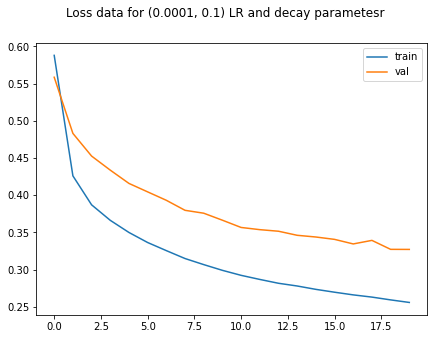

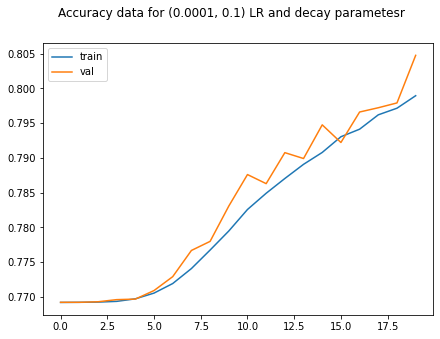

In [ ]:
%%time
from itertools import product

lrs = [1e-4]
decays = [ 1e-1]

parameters = list(product(lrs, decays))

loss_history_train_total = []
loss_history_val_total = []
train_history_total = []
val_history_total = []

for lr, decay in parameters:
  print(f'Testing {lr} lr and {decay} decay...')
  model = models.resnet18(pretrained=True)
  model.fc = nn.Linear(512, 26)

  optimizer = optim.Adam(model.parameters(), lr=lr, weight_decay = decay)
  scheduler = optim.lr_scheduler.ExponentialLR(optimizer, gamma=0.95)
  epochs_num = 20
  proba_threshold = 0.9
  device = 'cuda'
  loss = nn.BCEWithLogitsLoss()

  loss_history_train, loss_history_val, train_history, val_history = train_model(model, train_loader, val_loader,  
                                                                                loss,  optimizer, scheduler,
                                                                                 epochs_num, proba_threshold, None)
  
  loss_history_train_total.append(loss_history_train)
  loss_history_val_total.append(loss_history_val)
  train_history_total.append(train_history)
  val_history_total.append(val_history)

# visualize training results
for idx in range(len(parameters)):
  visualise_training_results(loss_history_train_total[idx], loss_history_val_total[idx], parameters[idx], 'Loss')
  visualise_training_results(train_history_total[idx], val_history_total[idx], parameters[idx],  'Accuracy')

**Conclusion^** old params suites well.

## 6.3. Train 100 epochs with the cropped dataset

In [ ]:
model = models.resnet18(pretrained=True)
model.fc = nn.Linear(512, 26)

lr = 1e-4
weight_decay = 1e-1

optimizer = optim.Adam(model.parameters(), lr=lr, weight_decay = weight_decay)
scheduler = optim.lr_scheduler.ExponentialLR(optimizer, gamma=0.95)
epochs_num = 30
proba_threshold = 0.9
best_weights_path = '/content/drive/MyDrive/resnet/cropped/'
device = 'cuda'
loss = nn.BCEWithLogitsLoss()

loss_history_train, loss_history_val, train_history, val_history = train_model(model, train_loader, val_loader,  
                                                                                loss,  optimizer, scheduler, 
                                                                               epochs_num, proba_threshold, best_weights_path)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:37: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:101: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).


The best weights snapshot done. Epoch: 0
Epoch 0. Average train loss: 0.5611885083027375, Average val loss: 0.5408400744199753, Train accuracy: 0.76927880859375, Val accuracy: 0.7693846435546875
The best weights snapshot done. Epoch: 1
Epoch 1. Average train loss: 0.4140538405149411, Average val loss: 0.4742681384086609, Train accuracy: 0.769375, Val accuracy: 0.7695384521484375
The best weights snapshot done. Epoch: 2
Epoch 2. Average train loss: 0.3788997187064244, Average val loss: 0.4473123326897621, Train accuracy: 0.7694806518554688, Val accuracy: 0.76984619140625
The best weights snapshot done. Epoch: 3
Epoch 3. Average train loss: 0.3590915997823079, Average val loss: 0.4283653646707535, Train accuracy: 0.7699518432617187, Val accuracy: 0.7699231567382813
The best weights snapshot done. Epoch: 4
Epoch 4. Average train loss: 0.34316345437979084, Average val loss: 0.41228652000427246, Train accuracy: 0.7710482177734375, Val accuracy: 0.7712308349609375
The best weights snapshot d

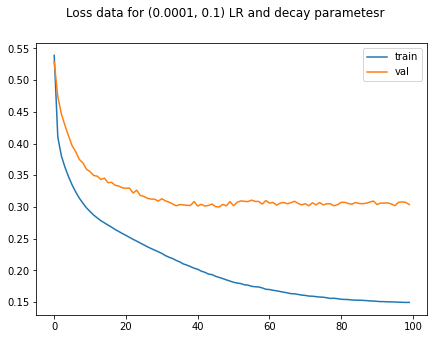

In [ ]:
visualise_training_results(loss_history_train, loss_history_val, (lr, weight_decay), 'Loss')

In [ ]:
# rollback to best checkpoint after training and save for futher usage as a standalone model
model = models.resnet18(pretrained=True)
model.fc = nn.Linear(512, 26)
lr = 1e-4
weight_decay = 1e-1
optimizer = optim.Adam(model.parameters(), lr=lr, weight_decay = weight_decay)

checkpoint = torch.load('/content/drive/MyDrive/resnet/cropped/resnet_best.pt')

model.load_state_dict(checkpoint['model_state_dict'])
optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
epoch = checkpoint['epoch']
loss = checkpoint['loss']

model.eval()

torch.save(model, '/content/drive/MyDrive/resnet/resnet18cropped.model')

##6.4. Create embeddings database for cropped images

In [ ]:
# change the last layer to get 512 flat embeddings
class Identity(nn.Module):
    def __init__(self):
        super(Identity, self).__init__()
    def forward(self, x):
        return x

device = 'cuda'

# model = torch.load('/content/drive/MyDrive/resnet/resnet18.model')
resnet_cropped = torch.load('/content/drive/MyDrive/resnet/resnet18cropped.model')
resnet_cropped.fc = Identity()
resnet_cropped.to(device)

copy('/content/drive/MyDrive/yolo_weights/dress_only_best_100.pt', '/content/yolo_best.pt',)
yolo320 = torch.hub.load('ultralytics/yolov5', 'custom', path='/content/yolo_best.pt')
yolo320.conf = 0.2  # like it was trained
yolo320.iou = 0.2 # like it was trained

Using cache found in /root/.cache/torch/hub/ultralytics_yolov5_master


requirements: PyYAML>=5.3.1 not found and is required by YOLOv5, attempting auto-update...


YOLOv5 🚀 2021-11-8 torch 1.9.0+cu111 CUDA:0 (Tesla P100-PCIE-16GB, 16281MiB)




requirements: 1 package updated per /root/.cache/torch/hub/ultralytics_yolov5_master/requirements.txt
requirements: ⚠️ Restart runtime or rerun command for updates to take effect



Fusing layers... 
Model Summary: 224 layers, 7053910 parameters, 0 gradients
Adding AutoShape... 


In [ ]:
%%time
embeddings_total_cropped = []
filenames_total = []
target_total = []
resnet_cropped.eval()
with torch.no_grad():
  for idx, (x,y,filename) in enumerate(train_loader):
    x = x.to(device)
    filename = pd.Series(filename)
    embedding = resnet_cropped(x)
    embeddings_total_cropped.append(embedding)
    filenames_total.append(filename)
    target_total.append(y)

CPU times: user 20.1 s, sys: 762 ms, total: 20.9 s
Wall time: 20.8 s


In [ ]:
%%time
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.preprocessing import normalize
# convert to np to normalize
embeddings_total_cropped = torch.cat(embeddings_total_cropped, 0 ).cpu().detach().numpy()
embeddings_total_cropped = normalize(embeddings_total_cropped, norm='l2', axis=0, copy=True, return_norm=False)
embeddings_total_series = pd.Series(embeddings_total_cropped.tolist(), name = 'embedding')
# embeddings_total = embeddings_total.map(lambda x: np.array(x))

filenames_total = pd.concat(filenames_total, 0).reset_index(drop = True)
filenames_total.name = 'filename'
embeddings = pd.concat([embeddings_total_series, filenames_total], axis = 1)

target_total = torch.cat(target_total, 0 ).cpu().detach().numpy()
assert embeddings_total_cropped.shape[0], target_total.shape[0]

CPU times: user 157 ms, sys: 25.1 ms, total: 182 ms
Wall time: 181 ms


In [ ]:
with open('/content/drive/MyDrive/resnet/embeddingscropped.pickle', 'wb') as f:
  pickle.dump(embeddings_total_cropped, f)

## 6.5. Check whether the problem with pipeline was fixed or not

Check the embeddings by itself without yolo:

1 iteration 


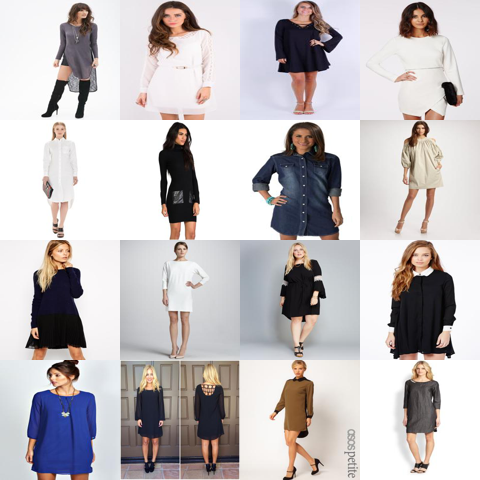

2 iteration 


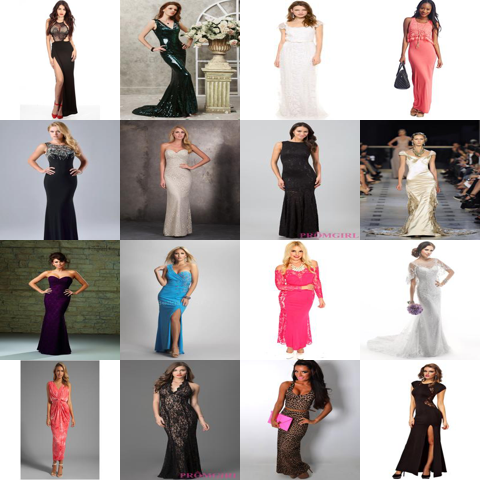

3 iteration 


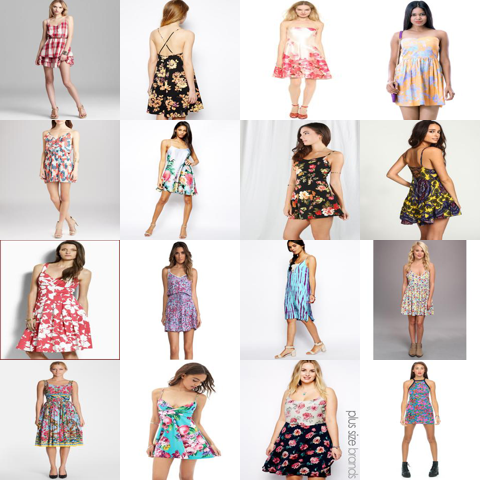

4 iteration 


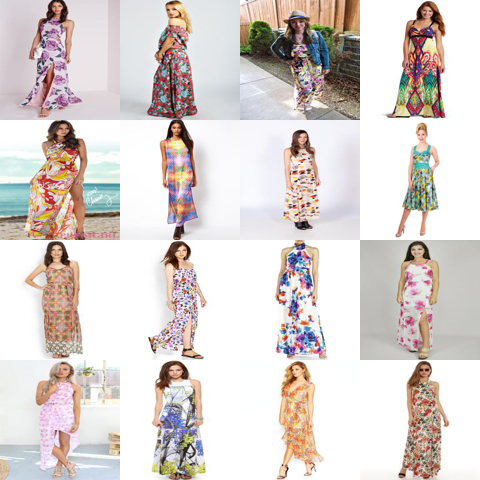

5 iteration 


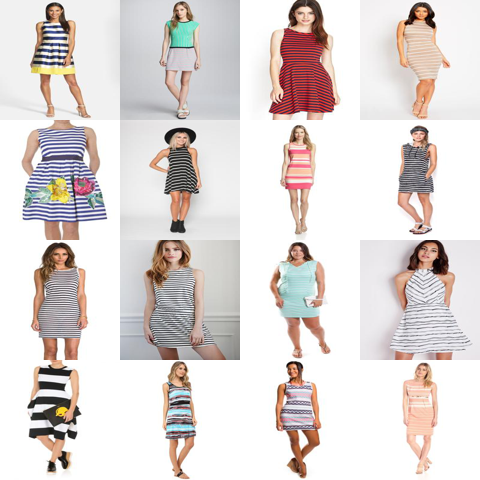

In [ ]:
for i in range(5):
  print(f"{i+1} iteration \n {f'='*10}")
  image_number = random.randint(0,3999)
  mosaic = show_similar_images(image_number, 16,  0.8, dbfloder, embeddings_total_cropped )
  display(mosaic)

Check pipeline:

Saved 1 image to buffer


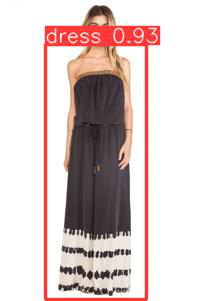

(199, 301)
1


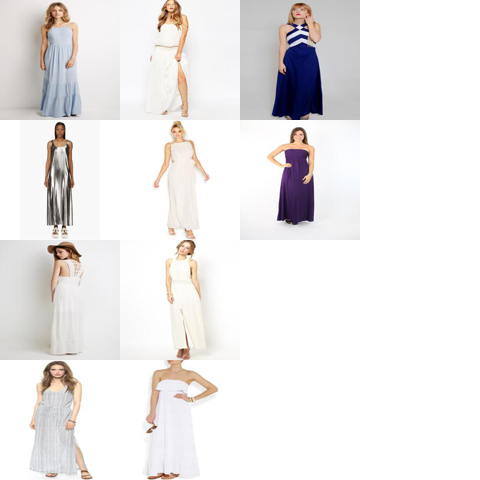

In [ ]:
img = Image.open("/content/drive/MyDrive/imagedb/14.jpg")

# display(img)

img_bbox, bbox = predict_bbox(yolo320, img, image_size)    
display(img_bbox)

print(img_bbox.size)
recognized_dresses = crop_dresses(img, bbox) 
embeddings= []
embeddings = get_embeddings( recognized_dresses, resnet_cropped, trans)

print(len(embeddings))

mosaic_list=[] 

for emb in embeddings:
  mosaic = get_similar_images_cuda(emb, 10,  0.8, '/content/drive/MyDrive/imagedb/', embeddings_total_cropped)
  mosaic_list.append(mosaic)
mosaic_list[0]

In [ ]:
cosine_similarity(emb.cpu().detach().numpy().reshape(1,-1), embeddings_total_cropped[14].reshape(1,-1))

array([[    0.57751]], dtype=float32)

**Conclusion:** embeddings are not even or similar. 

**Decision:** Have to learn on cropped by model.

#7 Train resnet on yolo output crop


## 7.1.Create dataset, croppped by YOLO

Check how many dresses per image YOLO detects. In dataset annotations only one bbox per image is marked. 

In [ ]:
train_dataset =  DressDataset(filelist_path = '/content/dataset/train.txt', category_path ='/content/dataset/train_cate.txt', 
                             attribites_path = '/content/dataset/train_attr.txt', image_folder = '/content/dataset/train/images', transform = None)

recognized_dresses_total = 0

for i in range(len(train_dataset)):
  img,_,_ = train_dataset[i]
  # display(img)
  result = yolo320(img, 320)
  bbox = result.pandas().xyxy[0]  
  # display(img_bbox)
  # print(img_bbox.size)
  recognized_dresses = crop_dresses(img, bbox) 
  recognized_dresses_total+=len(recognized_dresses)
print(f'All recognized dresses = {recognized_dresses_total}, all pictures are {len(train_dataset)}')

All recognized dresses = 4082, all pictures are 4016


At train dataset YOLO detects more than one image, but we'll omit it. 

Get YOLO outpur annotations to use inside new dataset class:

In [ ]:

train_dataset =  DressDataset(filelist_path = '/content/dataset/train.txt', category_path ='/content/dataset/train_cate.txt', 
                             attribites_path = '/content/dataset/train_attr.txt', image_folder = '/content/dataset/train/images', transform = None)
val_dataset = DressDataset(filelist_path = '/content/dataset/val.txt', category_path ='/content/dataset/val_cate.txt', 
                             attribites_path = '/content/dataset/val_attr.txt', image_folder = '/content/dataset/val/images', transform = None)


results_train = []
for idx, (x,y,filename) in enumerate(train_dataset):
  result = yolo320(x, 320)
  if len(result.pandas().xyxy[0]) == 0:
    results_train.append(np.array((0,0,0,0)).reshape(1,-1))
    continue
  results_train.append(result.pandas().xyxy[0].iloc[0,:].values[:4].reshape(1,-1))


results_val = []
for idx, (x,y,filename) in enumerate(val_dataset):
  result = yolo320(x, 320)
  if len(result.pandas().xyxy[0]) == 0:
    results_val.append(np.array((0,0,0,0)).reshape(1,-1))
    continue
  results_val.append(result.pandas().xyxy[0].iloc[0,:].values[:4].reshape(1,-1))

# bbox for images dataset
results_train = np.concatenate(results_train, 0)
results_val = np.concatenate(results_val, 0)


In [ ]:
# dataset changed to return cropped images
class DressCroppesYoloDataset(Dataset):
    def __init__(self, filelist_path, category_path, attribites_path, annotations_path, image_folder, yolo_boxes, transform):
        
        # collect attrs and categories
        cate = pd.read_csv(category_path, header = None, names = ['cate']).apply(lambda x: x-1, axis = 0)
        attrs = pd.read_csv(attribites_path, header = None, names = ['attrs'])
        attrs = attrs['attrs'].map(lambda x: np.fromstring(x, sep = ' '))
        
        with open(filelist_path, 'r') as f:
          images = f.readlines()
        files = pd.Series(images, name = 'filepath').map(lambda name: name[:-1].replace('img/', '').replace('/', '_'))
        
        df_anno = pd.read_csv(annotations_path, 
                              delim_whitespace=True, header = None, names = ['category', 'x', 'y', 'w', 'h'])

        dataset_info = pd.concat([cate, attrs, files, df_anno], axis = 1)
        dataset_info['bbox'] = dataset_info.apply(lambda row: [row.x, row.y, row.w, row.h], axis = 1)

        # filter to get dresses only
        dataset_info = dataset_info[dataset_info.cate == 40]
        
        self.transform = transform
        self.filelist = dataset_info.filepath.values

        self.target = dataset_info['attrs'].values
        self.image_folder = image_folder
        self.yolo_boxes = yolo_boxes

    def __len__(self):
        return len(self.filelist)

    def __getitem__(self, index):        
        path_image = os.path.join(self.image_folder, self.filelist[index])
  
        image = Image.open(path_image).convert('RGB')
        # display(image)
        # crop bbox with yolo
       
        image = image.crop(self.yolo_boxes[index])
        # display(image)
        # print(image.size)
        labels = torch.Tensor(self.target[index])          
        if self.transform: 
          image = self.transform(image)
          
        return image, labels, path_image

trans = transforms.Compose([
  transforms.Resize((125, 225)),
  transforms.ToTensor(),
  transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225]), # imagenet
  transforms.RandomHorizontalFlip(p=0.2),
  transforms.RandomRotation(20),
])

train_dataset =  DressCroppesYoloDataset(filelist_path = '/content/dataset/train.txt', category_path ='/content/dataset/train_cate.txt', 
                             attribites_path = '/content/dataset/train_attr.txt', 
                             annotations_path = '/content/dataset/train_annotations.txt', image_folder = '/content/dataset/train/images', yolo_boxes = results_train, transform = trans)
val_dataset = DressCroppesYoloDataset(filelist_path = '/content/dataset/val.txt', category_path ='/content/dataset/val_cate.txt', 
                             attribites_path = '/content/dataset/val_attr.txt', 
                             annotations_path = '/content/dataset/val_annotations.txt', image_folder = '/content/dataset/val/images', yolo_boxes = results_val,transform = trans)
batch_size = 200
train_loader = DataLoader(train_dataset, batch_size=batch_size, drop_last=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, drop_last=True)


##7.2. Train resnet 100 epochs

In [ ]:
model = models.resnet18(pretrained=True)
model.fc = nn.Linear(512, 26)

lr = 1e-4
weight_decay = 1e-1

optimizer = optim.Adam(model.parameters(), lr=lr, weight_decay = weight_decay)
scheduler = optim.lr_scheduler.ExponentialLR(optimizer, gamma=0.95)
epochs_num = 120
proba_threshold = 0.9
best_weights_path = '/content/drive/MyDrive/resnet/cropped/'
device = 'cuda'
loss = nn.BCEWithLogitsLoss()

loss_history_train, loss_history_val, train_history, val_history = train_model(model, train_loader, val_loader,  
                                                                                loss,  optimizer, scheduler, 
                                                                               epochs_num, proba_threshold, best_weights_path)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:37: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:101: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).


The best weights snapshot done. Epoch: 0
Epoch 0. Average train loss: 0.6643681432071485, Average val loss: 1.063339650630951, Train accuracy: 0.769115478515625, Val accuracy: 0.7692308044433593
The best weights snapshot done. Epoch: 1
Epoch 1. Average train loss: 0.5107920091403159, Average val loss: 0.890360951423645, Train accuracy: 0.76928857421875, Val accuracy: 0.7692308044433593
The best weights snapshot done. Epoch: 2
Epoch 2. Average train loss: 0.44690191275195074, Average val loss: 0.8121957778930664, Train accuracy: 0.7692885131835937, Val accuracy: 0.7693269348144531
The best weights snapshot done. Epoch: 3
Epoch 3. Average train loss: 0.416430253731577, Average val loss: 0.7697776556015015, Train accuracy: 0.7696154174804688, Val accuracy: 0.77
The best weights snapshot done. Epoch: 4
Epoch 4. Average train loss: 0.39834708916513545, Average val loss: 0.7429028451442719, Train accuracy: 0.769990478515625, Val accuracy: 0.7699038696289062
The best weights snapshot done. Ep

In [ ]:
# rollback to best checkpoint after training and save for futher usage as a standalone model
model = models.resnet18(pretrained=True)
model.fc = nn.Linear(512, 26)
lr = 1e-4
weight_decay = 1e-1
optimizer = optim.Adam(model.parameters(), lr=lr, weight_decay = weight_decay)

checkpoint = torch.load('/content/drive/MyDrive/resnet/cropped/resnet_best.pt')

model.load_state_dict(checkpoint['model_state_dict'])
optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
epoch = checkpoint['epoch']
loss = checkpoint['loss']

model.eval()

torch.save(model, '/content/drive/MyDrive/resnet/resnet18cropped2.model')

Downloading: "https://download.pytorch.org/models/resnet18-f37072fd.pth" to /root/.cache/torch/hub/checkpoints/resnet18-f37072fd.pth


  0%|          | 0.00/44.7M [00:00<?, ?B/s]

##7.3. Get new cropped embeddings after YOLO cropping

In [ ]:
# change the last layer to get 512 flat embeddings
class Identity(nn.Module):
    def __init__(self):
        super(Identity, self).__init__()
    def forward(self, x):
        return x

device = 'cuda'

# model = torch.load('/content/drive/MyDrive/resnet/resnet18.model')
resnet_cropped = torch.load('/content/drive/MyDrive/resnet/resnet18cropped2.model')
resnet_cropped.fc = Identity()
resnet_cropped.to(device)

copy('/content/drive/MyDrive/yolo_weights/dress_only_best_100.pt', '/content/yolo_best.pt',)
yolo320 = torch.hub.load('ultralytics/yolov5', 'custom', path='/content/yolo_best.pt')
yolo320.conf = 0.2  # like it was trained
yolo320.iou = 0.2 # like it was trained

Downloading: "https://github.com/ultralytics/yolov5/archive/master.zip" to /root/.cache/torch/hub/master.zip


requirements: PyYAML>=5.3.1 not found and is required by YOLOv5, attempting auto-update...


YOLOv5 🚀 2021-11-8 torch 1.9.0+cu111 CUDA:0 (Tesla P100-PCIE-16GB, 16281MiB)

Fusing layers... 


  Attempting uninstall: PyYAML
    Found existing installation: PyYAML 3.13
    Uninstalling PyYAML-3.13:
      Successfully uninstalled PyYAML-3.13

requirements: 1 package updated per /root/.cache/torch/hub/ultralytics_yolov5_master/requirements.txt
requirements: ⚠️ Restart runtime or rerun command for updates to take effect



Model Summary: 224 layers, 7053910 parameters, 0 gradients
Adding AutoShape... 


In [ ]:
trans = transforms.Compose([
  transforms.Resize((125, 225)), # mean sizes of detected bbox
  transforms.ToTensor(),
  transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225]), # imagenet
])

train_dataset =  DressCroppesYoloDataset(filelist_path = '/content/dataset/train.txt', category_path ='/content/dataset/train_cate.txt', 
                             attribites_path = '/content/dataset/train_attr.txt', 
                             annotations_path = '/content/dataset/train_annotations.txt', image_folder = '/content/dataset/train/images', yolo_boxes = results_train, 
                             transform = trans)
val_dataset = DressCroppesYoloDataset(filelist_path = '/content/dataset/val.txt', category_path ='/content/dataset/val_cate.txt', 
                             attribites_path = '/content/dataset/val_attr.txt', 
                             annotations_path = '/content/dataset/val_annotations.txt', image_folder = '/content/dataset/val/images', yolo_boxes = results_val,
                             transform = trans)

In [ ]:
%%time
embeddings_total_cropped = []
filenames_total = []
target_total = []
resnet_cropped.eval()
with torch.no_grad():
  for idx, (x,y,filename) in enumerate(train_loader):
    # print(transforms.ToTensor()(x).shape)
    x = x.to(device)
    filename = pd.Series(filename)
    embedding = resnet_cropped(x)
    embeddings_total_cropped.append(embedding)
    filenames_total.append(filename)
    target_total.append(y)

CPU times: user 20 s, sys: 885 ms, total: 20.9 s
Wall time: 20.8 s


In [ ]:
# convert to np to normalize
embeddings_total_cropped = torch.cat(embeddings_total_cropped, 0 ).cpu().detach().numpy()
embeddings_total_cropped = normalize(embeddings_total_cropped, norm='l2', axis=0, copy=True, return_norm=False)
embeddings_total_series = pd.Series(embeddings_total_cropped.tolist(), name = 'embedding')
# embeddings_total = embeddings_total.map(lambda x: np.array(x))

filenames_total = pd.concat(filenames_total, 0).reset_index(drop = True)
filenames_total.name = 'filename'
embeddings = pd.concat([embeddings_total_series, filenames_total], axis = 1)

target_total = torch.cat(target_total, 0 ).cpu().detach().numpy()
assert embeddings_total_cropped.shape[0], target_total.shape[0]

In [ ]:
with open('/content/drive/MyDrive/resnet/emb_cropped_by_model.pickle', 'wb') as f:
  pickle.dump(embeddings_total_cropped, f)

# 8 Final pipeline test

##  YOLO + resnet, learned on cropeed by YOLO dataset

Checking with the sames image, like in chapter 6.5

Saved 1 image to buffer


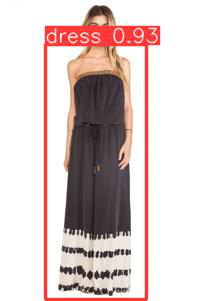

Int64Index([14, 574, 514, 977, 553, 3776, 2323, 775, 605, 3655], dtype='int64')


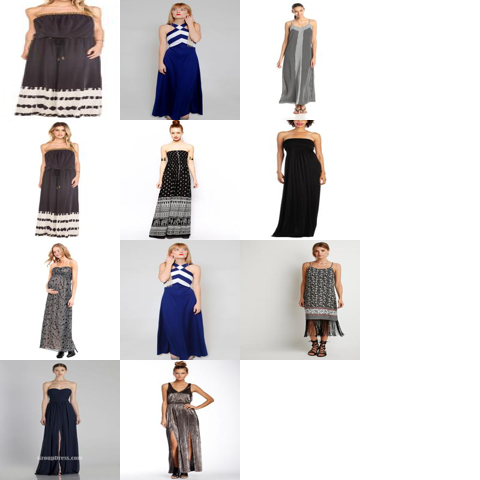

In [ ]:
trans = transforms.Compose([
  transforms.Resize((125, 225)), # mean sizes of detected bbox
  transforms.ToTensor(),
  transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225]), # imagenet
])

img = Image.open("/content/drive/MyDrive/imagedb/14.jpg")

img_bbox, bbox = predict_bbox(yolo320, img, image_size)    
display(img_bbox)

# print(img_bbox.size)
recognized_dresses = crop_dresses(img, bbox) 
embeddings= []
embeddings = get_embeddings( recognized_dresses, resnet_cropped, trans)

# print(len(embeddings))

mosaic_list=[] 

for recognized_dress, emb in zip(recognized_dresses, embeddings):
  mosaic = get_similar_images_cuda(emb, 10,  0.8, '/content/drive/MyDrive/imagedb/', embeddings_total_cropped, recognized_dress)
  mosaic_list.append(mosaic)
mosaic_list[0]

Checking similarity again:

In [ ]:
cosine_similarity(emb.cpu().detach().numpy().reshape(1,-1), embeddings_total_cropped[14].reshape(1,-1))

array([[    0.94878]], dtype=float32)

Check full pipeline at arbitary images:

Saved 1 image to buffer


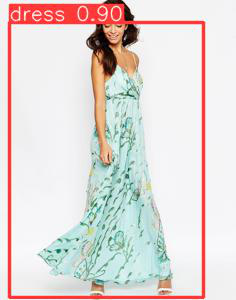

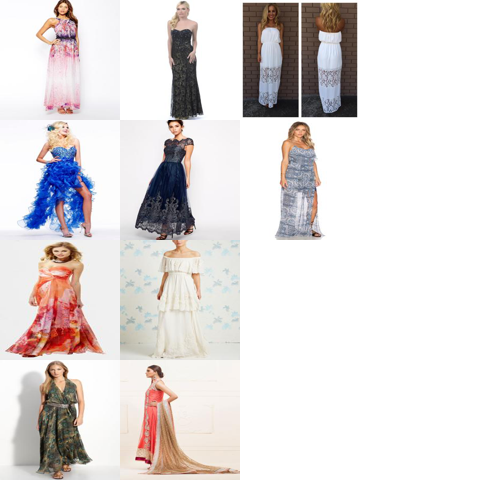

Saved 1 image to buffer


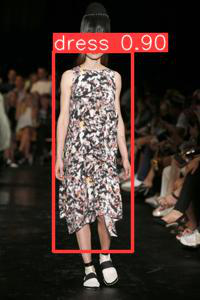

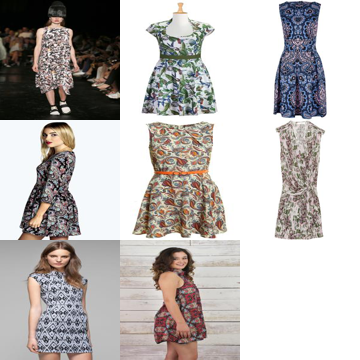

Saved 1 image to buffer


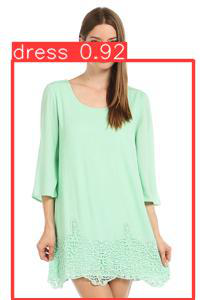

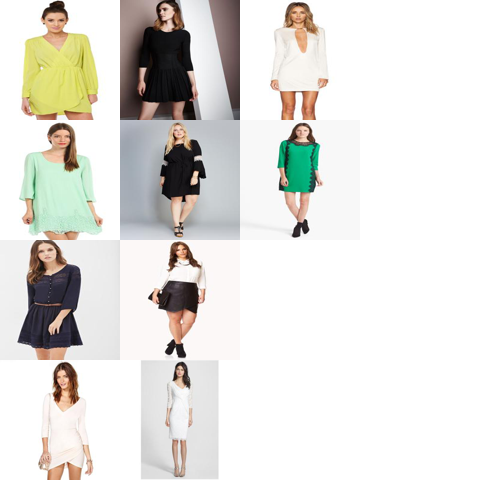

Saved 1 image to buffer


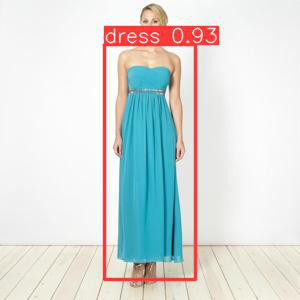

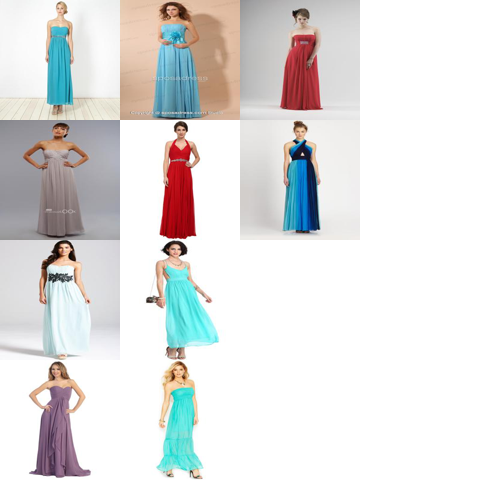

Saved 1 image to buffer


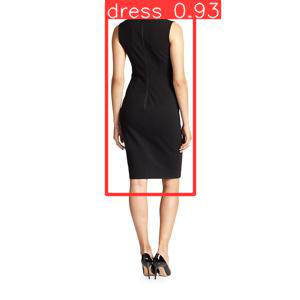

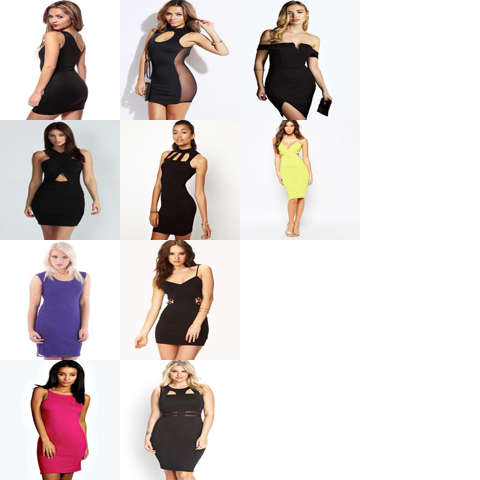

In [ ]:
for i in range(5):
  image_number = random.randint(0,3999)
  img = Image.open(f"/content/drive/MyDrive/imagedb/{image_number}.jpg")

  img_bbox, bbox = predict_bbox(yolo320, img, image_size)    
  display(img_bbox)

  # print(img_bbox.size)
  recognized_dresses = crop_dresses(img, bbox) 
  embeddings= []
  embeddings = get_embeddings( recognized_dresses, resnet_cropped, trans)

  # print(len(embeddings))

  mosaic_list=[] 

  for emb in embeddings:
    mosaic = get_similar_images_cuda(emb, 10,  0.8, '/content/drive/MyDrive/imagedb/', embeddings_total_cropped)
    mosaic_list.append(mosaic)
  display(mosaic_list[0])

**Conclusion:** works well.